In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import umap
import seaborn as sns
import warnings
import matplotlib.image as mpimg
from matplotlib.colors import LinearSegmentedColormap
import sys
import gc
from pympler import asizeof

import sys

sys.path.append("../src")

warnings.filterwarnings("ignore")
sc.settings.verbosity = 0

<script>
document.title = "scRNA Analysis";
</script>


In [2]:
from genes import marker_genes_ids
from constants import replicate_palette, palette, time_points

In [3]:
# set the default figure size and resolution
mpl.rcParams['figure.figsize'] = (5, 5)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.figsize'] = (5, 5)
mpl.rcParams['font.family'] = 'sans-serif' 
mpl.rcParams['font.sans-serif'] = ['Helvetica']
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype']  = 42
mpl.rcParams['svg.fonttype'] = 'none'
mpl.rcParams['text.usetex'] = False

# AX4

We will create a UMAP visualization using UCE embeddings. [Universal Cell Embedding](https://www.biorxiv.org/content/10.1101/2023.11.28.568918v2) (UCE) provides a unified "map" for representing cells based on their gene activity, independent of species, tissue, or experimental conditions. This approach enables the comparison and analysis of millions of cells in a standardized, biologically meaningful way, revealing patterns and similarities across datasets. In this case, we’ll generate a UMAP of AX4 data spanning all time points, with time, fluorescent tags, outliers, and clusters visualized. Outliers were detected using thresholds based on the median absolute deviation (MAD), marking cells with extreme values in total counts, genes detected, and mitochondrial read fractions as potential outliers. Cells exceeding 5 MADs for general metrics or 3 MADs for mitochondrial fractions were flagged.

In [4]:
adata = sc.read(
    filename=f"../data/processed/AX4/AX4_00hr.h5ad"
)

In [5]:
id2sym = dict(zip(adata.var["gene_ids"], adata.var_names))

to_examine = ["prespore_all", "prestalk_all"]
all_markers = {
    grp: sorted([id2sym[g] for g in ids if g in id2sym])
    for grp, ids in marker_genes_ids.items()
    if grp in to_examine
}
to_examine = ["prespore_all"]
prespore_all = {
    grp: sorted([id2sym[g] for g in ids if g in id2sym])
    for grp, ids in marker_genes_ids.items()
    if grp in to_examine
}

to_examine = ["prespore_yes", "prestalk_yes"]
yes_markers = {
    grp: sorted([id2sym[g] for g in ids if g in id2sym])
    for grp, ids in marker_genes_ids.items()
    if grp in to_examine
}

to_examine = ["prespore_maybe", "prestalk_maybe"]
maybe_markers = {
    grp: sorted([id2sym[g] for g in ids if g in id2sym])
    for grp, ids in marker_genes_ids.items()
    if grp in to_examine
}

to_examine = ["common_prespore", "common_prestalk"]
type_markers = {
    grp: sorted([id2sym[g] for g in ids if g in id2sym])
    for grp, ids in marker_genes_ids.items()
    if grp in to_examine
}

In [6]:
adata.obs["time"] = time_points[0]
adata.obs["strain"] = "AX4"

for tp in time_points[1:]:
    adata_new = sc.read(filename=f"../data/processed/AX4/AX4_{tp}.h5ad")
    adata_new.obs["time"] = tp
    adata_new.obs["strain"] = "AX4"
    adata = sc.concat(
        [adata, adata_new],
        join="outer",
        merge="first",
    )
    adata.var = adata.var[["gene_ids"]].copy()

adata.var_names_make_unique()
adata.obs_names_make_unique()

In [7]:
umap_adata = umap.UMAP(random_state=42)
umap_adata.fit(adata.obsm["X_uce"]) 
adata.obsm["X_uce_umap"] = umap_adata.transform(adata.obsm["X_uce"])

In [8]:
sc.pp.neighbors(adata, use_rep='X_uce')
sc.tl.leiden(adata, resolution=1.5)

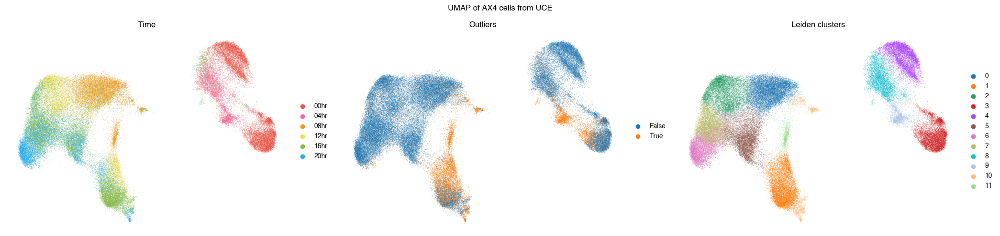

In [9]:
fig, ax = plt.subplots(1, 3, figsize=(21, 5))
sc.pl.embedding(
    adata,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    palette=palette,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata,
    basis='X_uce_umap',
    color='outlier_all',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Outliers",
)
sc.pl.embedding(
    adata,
    basis='X_uce_umap',
    color='leiden',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[2],
    show=False,
    title="Leiden clusters", 
)
plt.suptitle("UMAP of AX4 cells from UCE")
plt.tight_layout()
plt.show()

Most of the outliers are concentrated in the lower clusters. Comparing clusters 3 and 4, we observe significantly lower cell activity in cluster 3.

In [10]:
def get_counts_per_cell(adata, cluster_label):
    cluster_cells = adata[adata.obs['leiden'] == str(cluster_label)]
    counts_per_cell = np.array(cluster_cells.X.sum(axis=1)).flatten()
    average_counts = counts_per_cell.mean()
    print(f"Average counts per cell for cluster {cluster_label}:", average_counts)
    return pd.DataFrame({'Cluster': f'Cluster {cluster_label}', 'Total Counts': counts_per_cell})

Average counts per cell for cluster 0: 13070.09
Average counts per cell for cluster 1: 1015.24
Average counts per cell for cluster 2: 13383.016
Average counts per cell for cluster 3: 1658.9143
Average counts per cell for cluster 4: 25747.473
Average counts per cell for cluster 5: 14201.263
Average counts per cell for cluster 6: 9483.32
Average counts per cell for cluster 7: 10612.995
Average counts per cell for cluster 8: 23088.879
Average counts per cell for cluster 9: 2998.0312
Average counts per cell for cluster 10: 2313.3042
Average counts per cell for cluster 11: 1587.2067


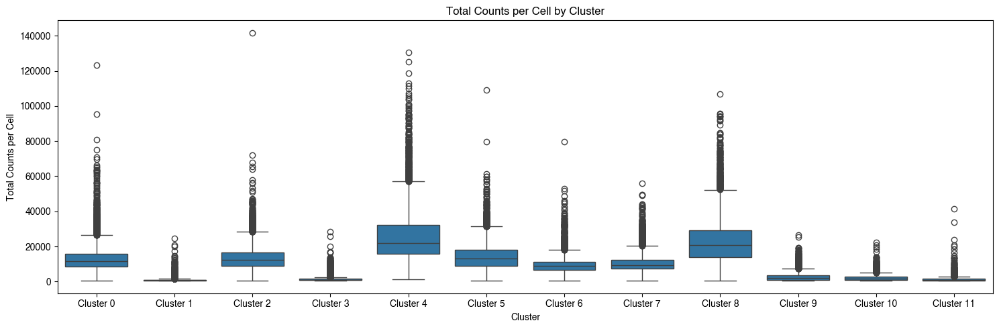

In [11]:
clusters_to_compare = range(0, len(adata.obs['leiden'].unique()))
data_frames = [get_counts_per_cell(adata, cluster) for cluster in clusters_to_compare]
combined_df = pd.concat(data_frames)

plt.figure(figsize=(15, 5))
sns.boxplot(data=combined_df, x='Cluster', y='Total Counts')
plt.title("Total Counts per Cell by Cluster")
plt.ylabel("Total Counts per Cell")
plt.xlabel("Cluster")
plt.tight_layout()
plt.show()

 Let's filter out the outliers and see the UMAP again.

In [12]:
adata_outlier = adata[adata.obs['outlier_all'] == False]
umap_adata_outlier = umap.UMAP(random_state=42)
umap_adata_outlier.fit(adata_outlier.obsm["X_uce"]) 
adata_outlier.obsm["X_uce_umap"] = umap_adata_outlier.transform(adata_outlier.obsm["X_uce"])

In [13]:
sc.pp.neighbors(adata_outlier, use_rep='X_uce')
sc.tl.leiden(adata_outlier, resolution=0.5)

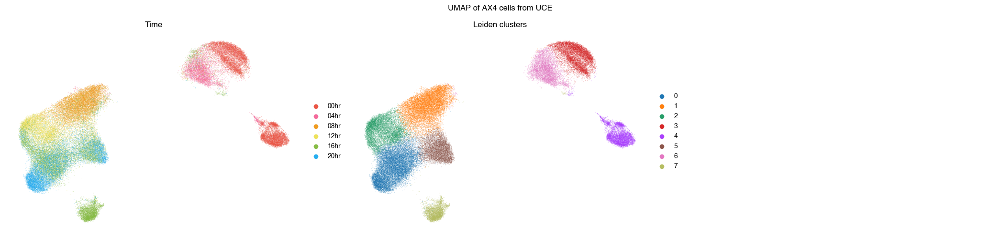

In [14]:
fig, ax = plt.subplots(1, 3, figsize=(21, 5))
sc.pl.embedding(
    adata_outlier,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    palette=palette,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata_outlier,
    basis='X_uce_umap',
    color='leiden',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters", 
)
ax[2].axis('off')
plt.suptitle("UMAP of AX4 cells from UCE")
plt.tight_layout()
plt.show()

Lets's see the total counts per cell in the clusters.

Average counts per cell for cluster 0: 10266.089
Average counts per cell for cluster 1: 13529.891
Average counts per cell for cluster 2: 13358.483
Average counts per cell for cluster 3: 25785.727
Average counts per cell for cluster 4: 1511.3215
Average counts per cell for cluster 5: 14620.685
Average counts per cell for cluster 6: 23234.207
Average counts per cell for cluster 7: 991.70386

Median counts per cell for cluster 0: 9079.0
Median counts per cell for cluster 1: 11860.0
Median counts per cell for cluster 2: 12356.0
Median counts per cell for cluster 3: 21881.0
Median counts per cell for cluster 4: 1023.0
Median counts per cell for cluster 5: 13602.0
Median counts per cell for cluster 6: 20766.0
Median counts per cell for cluster 7: 756.0


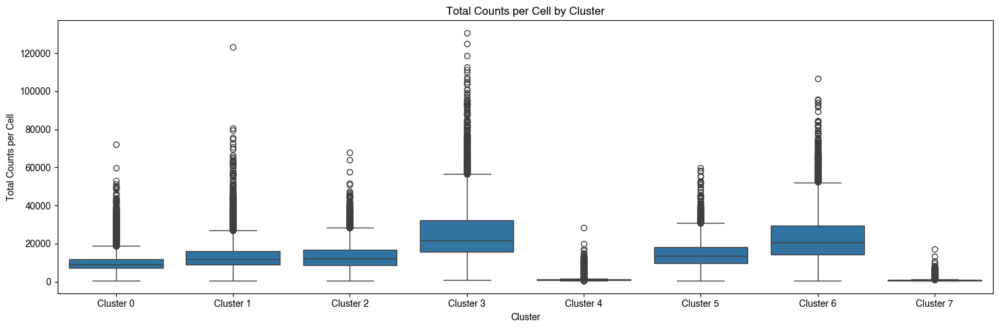

In [15]:
def get_median_counts_per_cell(adata, cluster_label):
    cluster_cells = adata[adata.obs['leiden'] == str(cluster_label)]
    counts_per_cell = np.array(cluster_cells.X.sum(axis=1)).flatten()
    median_counts = np.median(counts_per_cell)
    print(f"Median counts per cell for cluster {cluster_label}:", median_counts)
    return median_counts

clusters_to_compare = range(0, len(adata_outlier.obs['leiden'].unique()))
data_frames = [get_counts_per_cell(adata_outlier, cluster) for cluster in clusters_to_compare]
print()
median_counts = {cluster: get_median_counts_per_cell(adata_outlier, cluster) for cluster in clusters_to_compare}
combined_df = pd.concat(data_frames)

plt.figure(figsize=(15, 5))
sns.boxplot(data=combined_df, x='Cluster', y='Total Counts')
plt.title("Total Counts per Cell by Cluster")
plt.ylabel("Total Counts per Cell")
plt.xlabel("Cluster")
plt.tight_layout()
plt.show()


Let’s filter out clusters 4 and 7, as their read counts are significantly lower than those of the other clusters, and then visualize the data again.

In [16]:
mask = ~adata_outlier.obs['leiden'].isin(['4', '7'])
adata_new = adata_outlier[mask].copy()
adata_new.obs_names_make_unique()

In [17]:
umap_adata_new = umap.UMAP(random_state=42)
umap_adata_new.fit(adata_new.obsm["X_uce"]) 
adata_new.obsm["X_uce_umap"] = umap_adata_new.transform(adata_new.obsm["X_uce"])

Next, let's assign the tags. The function for that is in the `utils` module.

In [18]:
from utils import assign_markers
adata_new = assign_markers(adata_new, time_points)

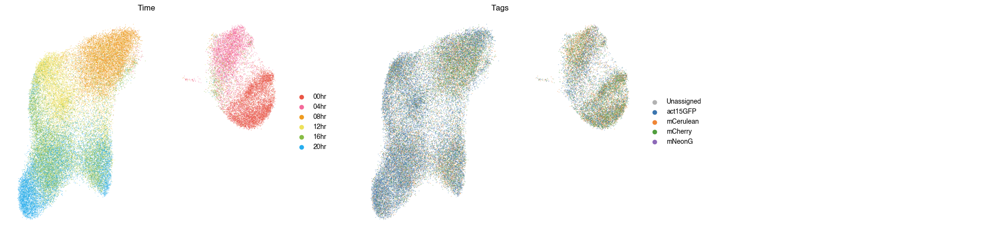

In [19]:
rows, cols = 1, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 5))
sc.pl.embedding(
    adata_new,
    basis="X_uce_umap",
    color="time",
    size=5,
    palette=palette,
    alpha=0.5,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata_new,
    basis="X_uce_umap",
    color="marker",
    size=5,
    alpha=0.5,
    palette=replicate_palette,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Tags",
)

ax[2].axis("off")

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)
            
plt.tight_layout()
plt.savefig("../results/figures/AX4/AX4.pdf", dpi=1200, backend="pgf")
plt.show()

We can observe the expected trajectory: the cells become similar at 8 hours and then begin diverging into two distinct paths.

In [20]:
adata_new_gfp = adata_new[adata_new.obs["marker"] == "act15GFP"]
adata_new_mcerulean = adata_new[adata_new.obs["marker"] == "mCerulean"]
adata_new_mcherry = adata_new[adata_new.obs["marker"] == "mCherry"]
adata_new_mneongreen = adata_new[adata_new.obs["marker"] == "mNeonG"]

In [21]:
adata_new.obs.marker.value_counts()

marker
act15GFP      21871
mCherry       12695
mCerulean     10945
Unassigned     2317
mNeonG         1155
Name: count, dtype: int64

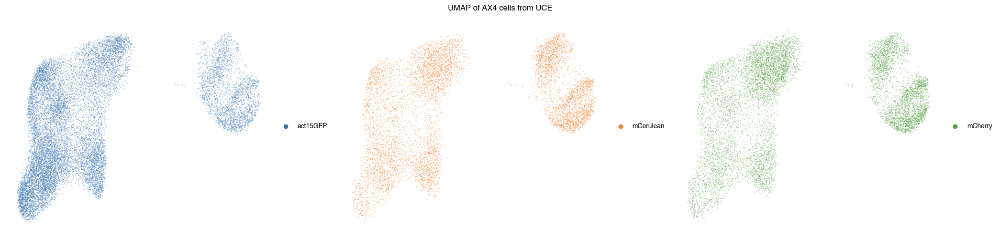

In [22]:
rows, cols = 1, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 5))

# Plot each embedding
sc.pl.embedding(
    adata_new_gfp,
    basis='X_uce_umap',
    color='marker',
    palette=replicate_palette,
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0],
    show=False,
    title="",
)
sc.pl.embedding(
    adata_new_mcerulean,
    basis='X_uce_umap',
    color='marker',
    size=5,
    palette=replicate_palette,
    alpha=0.5,
    frameon=False,
    ax=ax[1],
    show=False,
    title="",
)
sc.pl.embedding(
    adata_new_mcherry,
    basis='X_uce_umap',
    color='marker',
    palette=replicate_palette,
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[2],
    show=False,
    title="",
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(cols):
    xlims.append(ax[i].get_xlim())
    ylims.append(ax[i].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(cols):
    ax[i].set_xlim(x_min, x_max)
    ax[i].set_ylim(y_min, y_max)
    
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

# Add title and adjust layout
plt.suptitle("UMAP of AX4 cells from UCE")
plt.tight_layout()
plt.savefig("../results/figures/AX4/AX4_replicates.pdf", dpi=1200, backend="pgf")
plt.show()

In [23]:
adata_new_00hr = adata_new[adata_new.obs["time"] == "00hr"]
adata_new_04hr = adata_new[adata_new.obs["time"] == "04hr"]
adata_new_08hr = adata_new[adata_new.obs["time"] == "08hr"]
adata_new_12hr = adata_new[adata_new.obs["time"] == "12hr"]
adata_new_16hr = adata_new[adata_new.obs["time"] == "16hr"]
adata_new_20hr = adata_new[adata_new.obs["time"] == "20hr"]

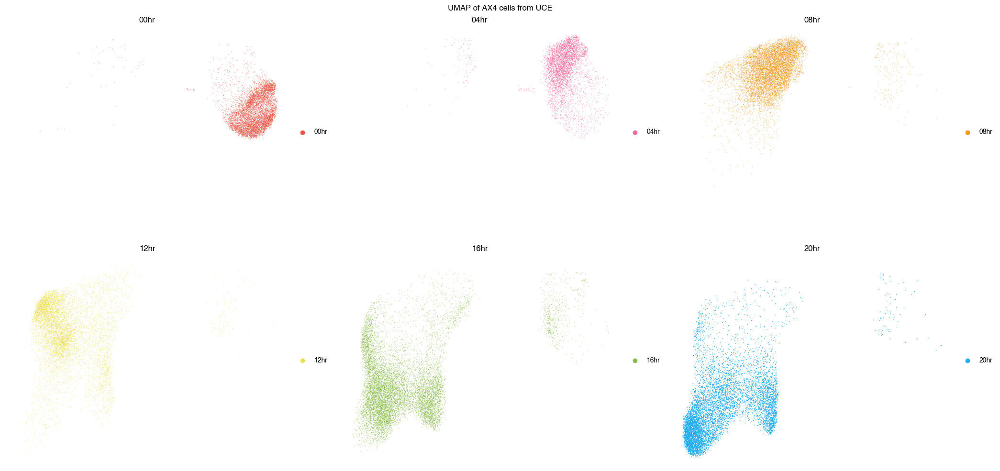

In [24]:
rows, cols = 2, 3

fig, ax = plt.subplots(rows, cols, figsize=(cols*7, rows*5))

# Plot each embedding
sc.pl.embedding(
    adata_new_00hr,
    basis='X_uce_umap',
    color='time',
    palette=palette,
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="00hr",
)
sc.pl.embedding(
    adata_new_04hr,
    basis='X_uce_umap',
    color='time',
    palette=palette,
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="04hr",
)
sc.pl.embedding(
    adata_new_08hr,
    basis='X_uce_umap',
    color='time',
    palette=palette,
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="08hr",
)
sc.pl.embedding(
    adata_new_12hr,
    basis='X_uce_umap',
    color='time',
    palette=palette,
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1][0],
    show=False,
    title="12hr",
)
sc.pl.embedding(
    adata_new_16hr,
    basis='X_uce_umap',
    color='time',
    palette=palette,
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1][1],
    show=False,
    title="16hr",
)
sc.pl.embedding(
    adata_new_20hr,
    basis='X_uce_umap',
    color='time',
    palette=palette,
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="20hr",
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(rows):
    for j in range(cols):
        xlims.append(ax[i][j].get_xlim())
        ylims.append(ax[i][j].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(rows):
    for j in range(cols):
        ax[i][j].set_xlim(x_min, x_max)
        ax[i][j].set_ylim(y_min, y_max)
        
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

# Add title and adjust layout
plt.suptitle("UMAP of AX4 cells from UCE")
plt.tight_layout()
plt.savefig("../results/figures/AX4/AX4_time.pdf", dpi=1200, backend="pgf")
plt.show()

Let's look at the expression of milestone genes that are upregulated or downregulated in each developmental stage.

In [25]:
adata_new_norm = adata_new.copy()
adata_new_norm.X = np.log1p(adata_new_norm.X)

In [26]:
for key in ['noagg_ripple_up', 'ripple_lag_up', 'lag_tag_up', 'tag_tip_up', 'tip_slug_up', 'slug_Mhat_up', 'Mhat_cul_up', 'cul_FB_up']:
    valid_genes = [gene for gene in marker_genes_ids[key] if gene in adata_new_norm.var["gene_ids"].values]
    mask = adata_new_norm.var["gene_ids"].isin(marker_genes_ids[key])
    subset_data = adata_new_norm[:, mask].X
    adata_new_norm.obs[key] = subset_data.mean(axis=1)


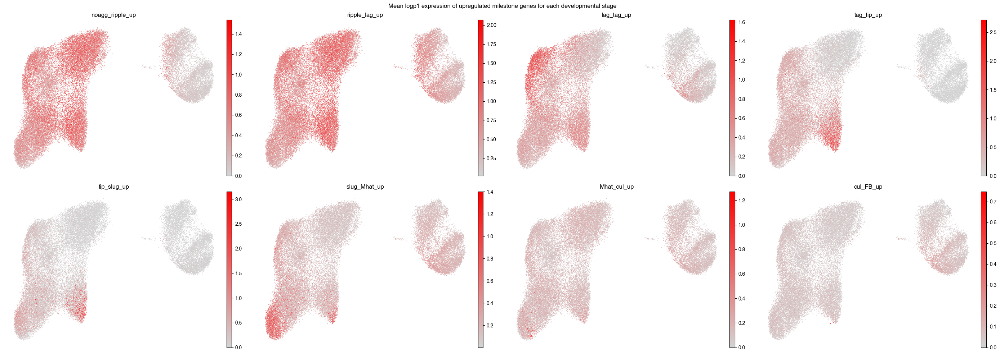

In [27]:
rows, cols = 2, 4

fig, ax = plt.subplots(rows, cols, figsize=(28, 10))

grey_to_red = LinearSegmentedColormap.from_list("GreyToRed", ["lightgrey", "red"])
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='noagg_ripple_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="noagg_ripple_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='ripple_lag_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="ripple_lag_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='lag_tag_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="lag_tag_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='tag_tip_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][3],
    show=False,
    title="tag_tip_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='tip_slug_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][0],
    show=False,
    title="tip_slug_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='slug_Mhat_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][1],
    show=False,
    title="slug_Mhat_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='Mhat_cul_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="Mhat_cul_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='cul_FB_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][3],
    show=False,
    title="cul_FB_up",
    color_map=grey_to_red,
)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)
            
plt.suptitle("Mean logp1 expression of upregulated milestone genes for each developmental stage")
plt.tight_layout()
plt.savefig("../results/figures/AX4/AX4_milestones_up.pdf", dpi=1200, backend="pgf")
plt.show()

In [28]:
for key in ['noagg_ripple_down', 'ripple_lag_down', 'lag_tag_down', 'tag_tip_down', 'tip_slug_down', 'slug_Mhat_down', 'Mhat_cul_down', 'cul_FB_down']:
    valid_genes = [gene for gene in marker_genes_ids[key] if gene in adata_new_norm.var["gene_ids"].values]
    mask = adata_new_norm.var["gene_ids"].isin(marker_genes_ids[key])
    if len(valid_genes) == 0:
        continue
    subset_data = adata_new_norm[:, mask].X
    adata_new_norm.obs[key] = subset_data.mean(axis=1)


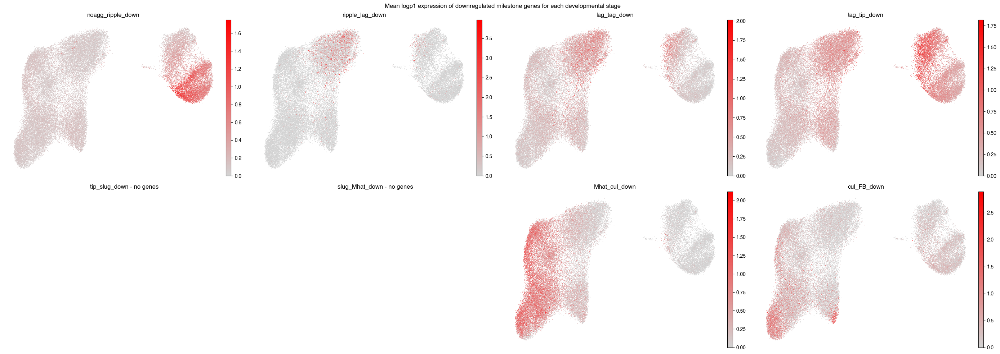

In [29]:
fig, ax = plt.subplots(2, 4, figsize=(28, 10))
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='noagg_ripple_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="noagg_ripple_down",
    color_map=grey_to_red,
    
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='ripple_lag_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="ripple_lag_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='lag_tag_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="lag_tag_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='tag_tip_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][3],
    show=False,
    title="tag_tip_down",
    color_map=grey_to_red,
)
ax[1][0].axis('off')
ax[1][0].set_title("tip_slug_down - no genes")
ax[1][1].axis('off')
ax[1][1].set_title("slug_Mhat_down - no genes")
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='Mhat_cul_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="Mhat_cul_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_new_norm,
    basis='X_uce_umap',
    color='cul_FB_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][3],
    show=False,
    title="cul_FB_down",
    color_map=grey_to_red,
)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

plt.suptitle("Mean logp1 expression of downregulated milestone genes for each developmental stage")
plt.tight_layout()
plt.savefig("../results/figures/AX4/AX4_milestones_down.pdf", dpi=1200, backend="pgf")
plt.show()

 Next, let’s classify the cells as prestalk or prespore at specific time points (12 hours, 16 hours, and 20 hours).

In [30]:

filter_ratio = adata_new.obs['time'].value_counts() / adata.obs['time'].value_counts()
print("Number of cells per time point before filtering:")
print(adata.obs['time'].value_counts().sort_index())
print()
print("Number of cells per time point after filtering:")
print(adata_new.obs['time'].value_counts().sort_index())
print()
print("Percentage of cells kept per time point:")
print(filter_ratio * 100)

Number of cells per time point before filtering:
time
00hr    13996
04hr     7122
08hr    11719
12hr    10726
16hr    18826
20hr    11016
Name: count, dtype: int64

Number of cells per time point after filtering:
time
00hr     6626
04hr     4823
08hr     9323
12hr     7725
16hr    11827
20hr     8659
Name: count, dtype: int64

Percentage of cells kept per time point:
time
00hr    47.342098
04hr    67.719742
08hr    79.554570
12hr    72.021257
16hr    62.822692
20hr    78.603849
Name: count, dtype: float64


## 12 Hours

In [31]:
adata_12hr = adata_new[adata_new.obs['time'] == "12hr"]
umap_adata_12hr = umap.UMAP(random_state=42)
umap_adata_12hr.fit(adata_12hr.obsm["X_uce"]) 
adata_12hr.obsm["X_uce_umap"] = umap_adata_12hr.transform(adata_12hr.obsm["X_uce"])
sc.pp.neighbors(adata_12hr, use_rep='X_uce')
sc.tl.leiden(adata_12hr, resolution=0.5)

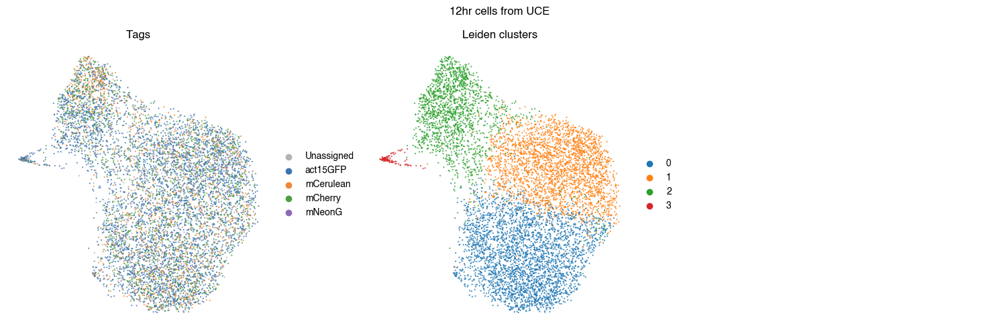

In [32]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
sc.pl.embedding(
    adata_12hr,
    basis='X_uce_umap',
    color='marker',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Tags",
)
sc.pl.embedding(
    adata_12hr,
    basis='X_uce_umap',
    color='leiden',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters", 
)
ax[2].axis('off')
plt.suptitle("12hr cells from UCE")
plt.tight_layout()
plt.show()

Let’s explore how some common prespore and prestalk markers are expressed across the clusters and identify the differentially expressed genes. Based on this analysis, we can classify the cells.

In [33]:
adata_12hr_norm = adata_12hr.copy()
adata_12hr_norm.X = np.log1p(adata_12hr_norm.X)

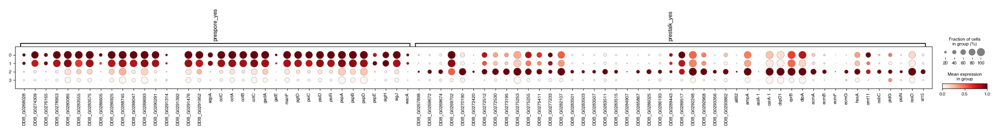

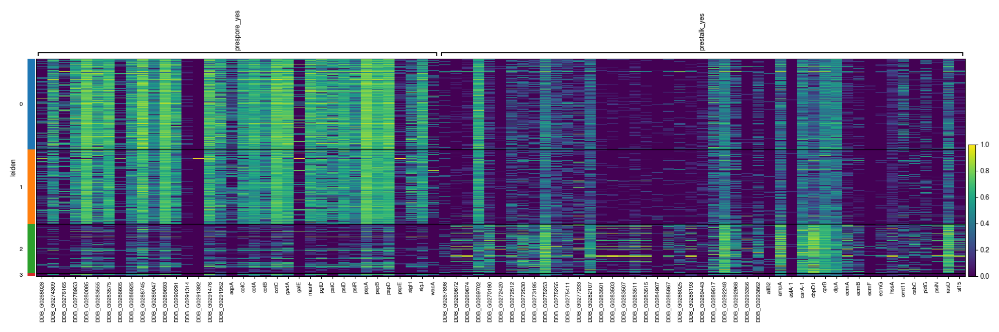

In [34]:
sc.pl.dotplot(
    adata_12hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    standard_scale="var",
    show=False,
    save="dotplot_12hr_yes.png",
)
sc.pl.heatmap(
    adata_12hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    use_raw=False,
    standard_scale="var",
    show=False,
    show_gene_labels=True,
    save="_heatmap_12hr_yes.png",
)
plt.close("all")

dotplot_img = mpimg.imread('figures/dotplot_dotplot_12hr_yes.png')
heatmap_img = mpimg.imread('figures/heatmap_heatmap_12hr_yes.png')
fig, axes = plt.subplots(1, 1, figsize=(20, 5))
axes.imshow(dotplot_img)
axes.axis('off')
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 1, figsize=(20, 10))
axes.imshow(heatmap_img)
axes.axis('off')
plt.tight_layout()
plt.show()

In [35]:
sc.tl.rank_genes_groups(
    adata_12hr_norm, groupby="leiden", method="wilcoxon", key_added="dea_leiden_2"
)
sc.pl.rank_genes_groups_dotplot(
    adata_12hr_norm,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_2",
    show=False,
    save="geneplot_12hr.png",
)
plt.close("all")

In [36]:
annotation = {
    "0": "psp",
    "1": "psp",
    "2": "pst",
}
adata_12hr.obs["12hr_annot"] = adata_12hr.obs.leiden.map(annotation)
adata_new.obs["12hr_annot"] = adata_12hr.obs["12hr_annot"].astype('category')

In [37]:
sc.pl.embedding(
    adata_12hr,
    basis='X_uce_umap',
    color='12hr_annot',
    size=10,
    alpha=0.8,
    frameon=False,
    show=False,
    title="Cell Type",
    save="celltype_12hr.png",
)
plt.close("all")

Let's also see the top 5 differentially expressed genes for each cluster and based on all this information, classify the cells as prestalk or prespore.

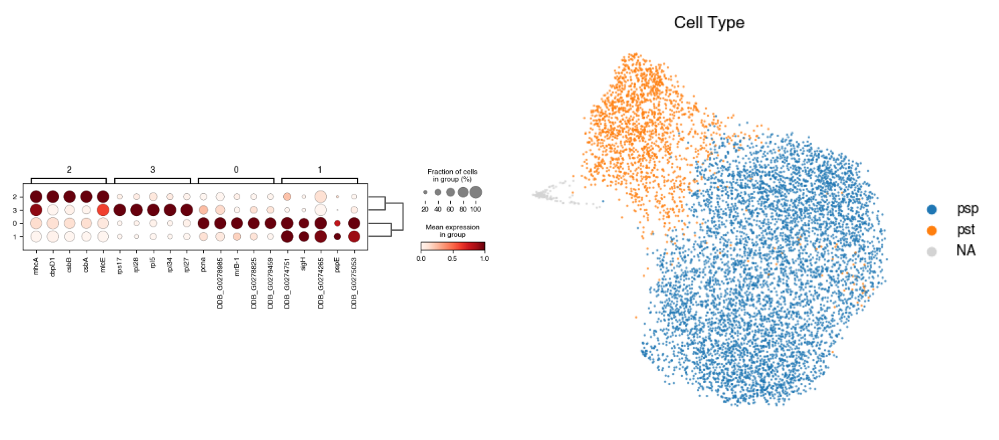

In [38]:
dotplot_img = mpimg.imread('figures/dotplot_geneplot_12hr.png')
heatmap_img = mpimg.imread('figures/X_uce_umapcelltype_12hr.png')
fig, axes = plt.subplots(1, 2, figsize=(15, 7))
axes[0].imshow(dotplot_img)
axes[0].axis('off')
axes[1].imshow(heatmap_img)
axes[1].axis('off')
plt.tight_layout()
plt.show()

In [39]:
result = adata_12hr_norm.uns["dea_leiden_2"]
groups = result['names'].dtype.names
top_genes = {group: result['names'][group][:5] for group in groups}
for group, genes in top_genes.items():
    print(f"Top genes for {group}: {list(genes)}")

Top genes for 0: ['pcna', 'DDB_G0278985', 'rnrB-1', 'DDB_G0278825', 'DDB_G0279459']
Top genes for 1: ['DDB_G0274751', 'sigH', 'DDB_G0274265', 'pspE', 'DDB_G0275053']
Top genes for 2: ['mhcA', 'cbpD1', 'csbB', 'csbA', 'mlcE']
Top genes for 3: ['rps17', 'rpl28', 'rpl5', 'rpl34', 'rpl27']


The classification is as follows (leiden cluster: cell type):

In [40]:
print(annotation)

{'0': 'psp', '1': 'psp', '2': 'pst'}


## 16 Hours







Now let's do the same for 16 hours.

In [41]:
adata_16hr = adata_new[adata_new.obs['time'] == "16hr"]
umap_adata_16hr = umap.UMAP(random_state=42)
umap_adata_16hr.fit(adata_16hr.obsm["X_uce"]) 
adata_16hr.obsm["X_uce_umap"] = umap_adata_16hr.transform(adata_16hr.obsm["X_uce"])
sc.pp.neighbors(adata_16hr, use_rep='X_uce')
sc.tl.leiden(adata_16hr, resolution=1)

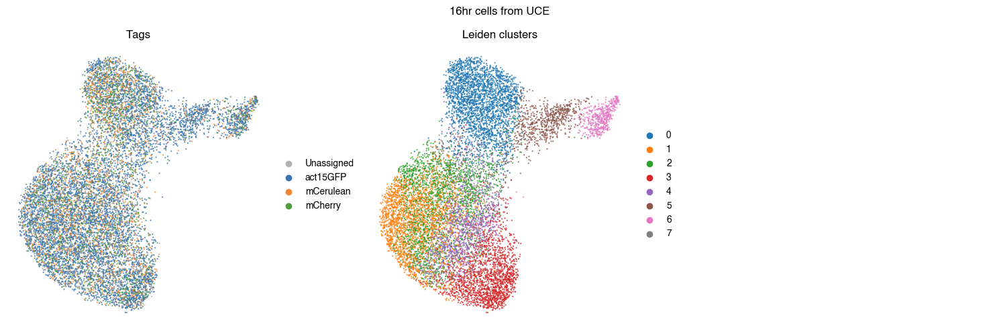

In [42]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
sc.pl.embedding(
    adata_16hr,
    basis='X_uce_umap',
    color='marker',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Tags",
)
sc.pl.embedding(
    adata_16hr,
    basis='X_uce_umap',
    color='leiden',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters", 
)
ax[2].axis('off')
plt.suptitle("16hr cells from UCE")
plt.tight_layout()
plt.show()

In [43]:
adata_16hr_norm = adata_16hr.copy()
adata_16hr_norm.X = np.log1p(adata_16hr_norm.X)

In [44]:
sc.tl.rank_genes_groups(
    adata_16hr_norm, groupby="leiden", method="wilcoxon", key_added="dea_leiden_2"
)
sc.pl.rank_genes_groups_dotplot(
    adata_16hr_norm,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_2",
    show=False,
    save="geneplot_16hr.png",
)
plt.close("all")

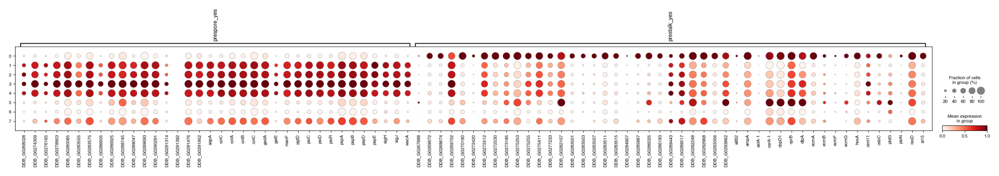

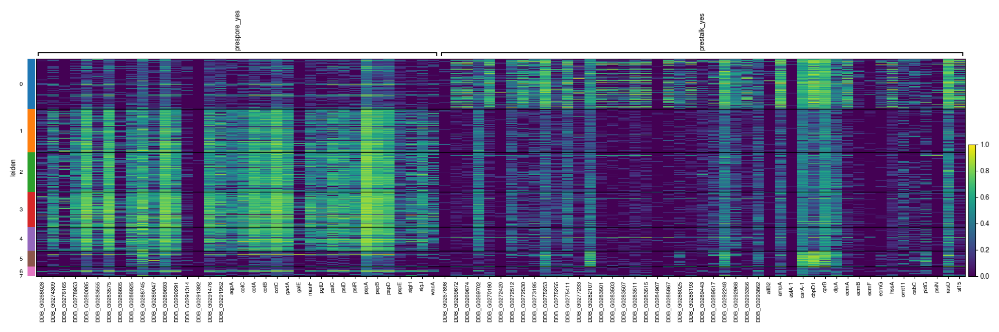

In [45]:
sc.pl.dotplot(
    adata_16hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    standard_scale="var",
    show=False,
    save="dotplot_16hr_yes.png",
)
sc.pl.heatmap(
    adata_16hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    use_raw=False,
    standard_scale="var",
    show=False,
    show_gene_labels=True,
    save="_heatmap_16hr_yes.png",
)
plt.close("all")

dotplot_img = mpimg.imread('figures/dotplot_dotplot_16hr_yes.png')
heatmap_img = mpimg.imread('figures/heatmap_heatmap_16hr_yes.png')
fig, axes = plt.subplots(1, 1, figsize=(20, 5))
axes.imshow(dotplot_img)
axes.axis('off')
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 1, figsize=(20, 10))
axes.imshow(heatmap_img)
axes.axis('off')
plt.tight_layout()
plt.show()

In [46]:
annotation = {
    "0": "pst",
    "5": "pst",
    "2": "psp",
    "4": "psp",
    "7": "psp",
    "1": "psp",
    "3": "psp"
    
}
adata_16hr.obs["16hr_annot"] = adata_16hr.obs.leiden.map(annotation)
adata_new.obs["16hr_annot"] = adata_16hr.obs["16hr_annot"].astype('category')

In [47]:
sc.pl.embedding(
    adata_16hr,
    basis='X_uce_umap',
    color='16hr_annot',
    size=10,
    alpha=0.8,
    frameon=False,
    show=False,
    title="Cell Type",
    save="celltype_16hr.png",
)
plt.close("all")

Let's also see the top 5 differentially expressed genes for each cluster and based on all this information, classify the cells as prestalk or prespore.

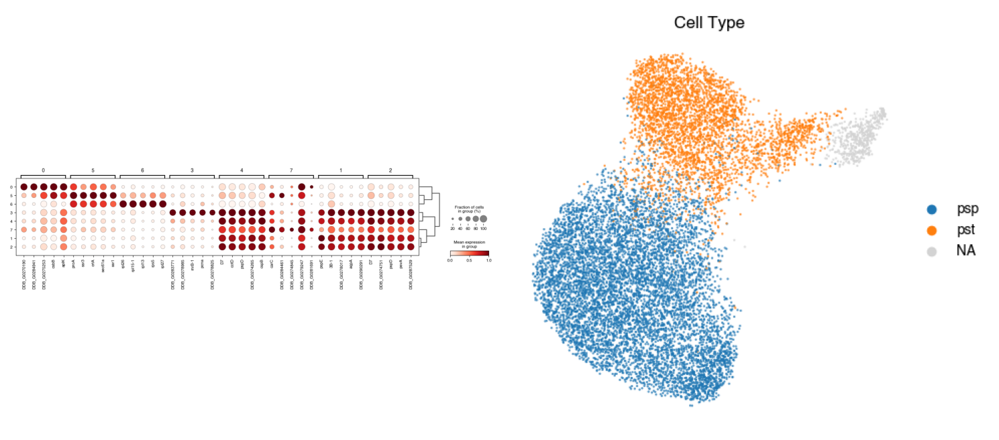

In [48]:
dotplot_img = mpimg.imread('figures/dotplot_geneplot_16hr.png')
heatmap_img = mpimg.imread('figures/X_uce_umapcelltype_16hr.png')
fig, axes = plt.subplots(1, 2, figsize=(15, 7))
axes[0].imshow(dotplot_img)
axes[0].axis('off')
axes[1].imshow(heatmap_img)
axes[1].axis('off')
plt.tight_layout()
plt.show()

In [49]:
result = adata_16hr_norm.uns["dea_leiden_2"]
groups = result['names'].dtype.names
top_genes = {group: result['names'][group][:5] for group in groups}
for group, genes in top_genes.items():
    print(f"Top genes for {group}: {list(genes)}")

Top genes for 0: ['DDB_G0270190', 'DDB_G0284941', 'DDB_G0275253', 'csbB', 'aplK']
Top genes for 1: ['pspE', '3B-1', 'DDB_G0278017', 'aqpA', 'DDB_G0290291']
Top genes for 2: ['D7', 'DDB_G0274751', 'pspD', 'psvA', 'DDB_G0287529']
Top genes for 3: ['DDB_G0283771', 'DDB_G0278985', 'rnrB-1', 'pcna', 'DDB_G0278825']
Top genes for 4: ['D7', 'cotD', 'pspD', 'DDB_G0274265', 'cspB']
Top genes for 5: ['proA', 'ssr3', 'crtA', 'sec61a', 'ssr1']
Top genes for 6: ['rpl26', 'rpl15-1', 'rpl13', 'rps5', 'rpl27']
Top genes for 7: ['carC', 'DDB_G0284461', 'DDB_G0274845', 'DDB_G0279247', 'DDB_G0281691']


The classification is as follows (leiden cluster: cell type):

In [50]:
print(annotation)

{'0': 'pst', '5': 'pst', '2': 'psp', '4': 'psp', '7': 'psp', '1': 'psp', '3': 'psp'}


## 20 Hours

Now let's do the same for 20 hours.

In [51]:
adata_20hr = adata_new[adata_new.obs['time'] == "20hr"]
umap_adata_20hr = umap.UMAP(random_state=42)
umap_adata_20hr.fit(adata_20hr.obsm["X_uce"]) 
adata_20hr.obsm["X_uce_umap"] = umap_adata_20hr.transform(adata_20hr.obsm["X_uce"])
sc.pp.neighbors(adata_20hr, use_rep='X_uce')
sc.tl.leiden(adata_20hr, resolution=0.5)

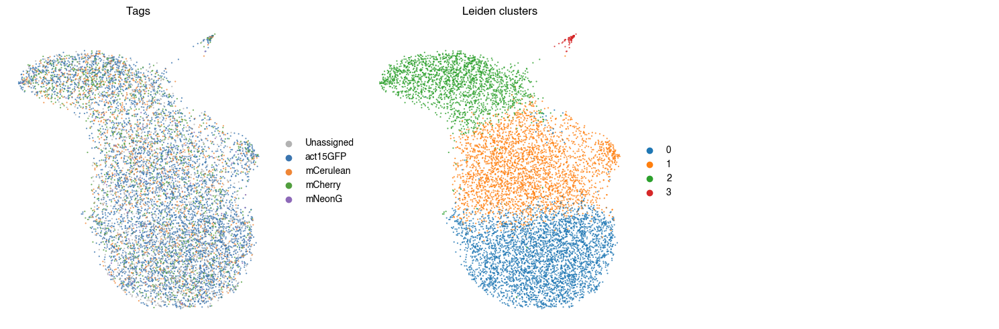

In [52]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
sc.pl.embedding(
    adata_20hr,
    basis='X_uce_umap',
    color='marker',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Tags",
)
sc.pl.embedding(
    adata_20hr,
    basis='X_uce_umap',
    color='leiden',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters", 
)
ax[2].axis('off')
plt.tight_layout()
plt.show()

In [53]:
adata_20hr_norm = adata_20hr.copy()
adata_20hr_norm.X = np.log1p(adata_20hr_norm.X)

In [54]:
sc.tl.rank_genes_groups(
    adata_20hr_norm, groupby="leiden", method="wilcoxon", key_added="dea_leiden_2"
)
sc.pl.rank_genes_groups_dotplot(
    adata_20hr_norm, groupby="leiden", standard_scale="var", n_genes=5, key="dea_leiden_2",
    show=False,
    save="geneplot_20hr.png",
)
plt.close("all")

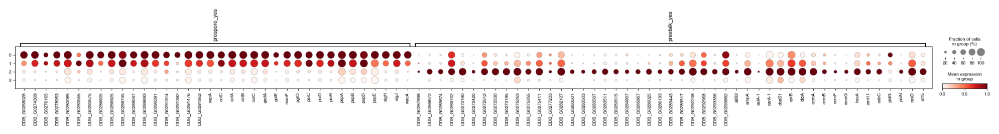

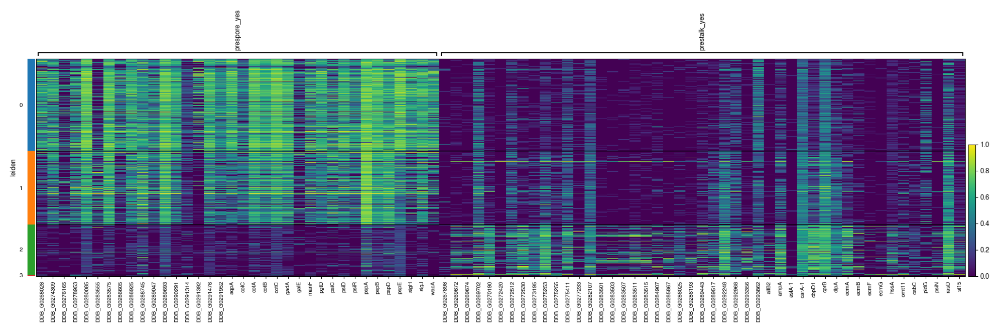

In [55]:
sc.pl.dotplot(
    adata_20hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    standard_scale="var",
    show=False,
    save="dotplot_20hr_yes.png",
)
sc.pl.heatmap(
    adata_20hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    use_raw=False,
    standard_scale="var",
    show=False,
    show_gene_labels=True,
    save="_heatmap_20hr_yes.png",
)
plt.close("all")

dotplot_img = mpimg.imread('figures/dotplot_dotplot_20hr_yes.png')
heatmap_img = mpimg.imread('figures/heatmap_heatmap_20hr_yes.png')
fig, axes = plt.subplots(1, 1, figsize=(20, 5))
axes.imshow(dotplot_img)
axes.axis('off')
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 1, figsize=(20, 10))
axes.imshow(heatmap_img)
axes.axis('off')
plt.tight_layout()
plt.show()

In [56]:
annotation = {
    "1": "psp",
    "0": "psp",
    "2": "pst",
}
adata_20hr.obs["20hr_annot"] = adata_20hr.obs.leiden.map(annotation)
adata_new.obs["20hr_annot"] = adata_20hr.obs["20hr_annot"].astype('category')

In [57]:
sc.pl.embedding(
    adata_20hr,
    basis='X_uce_umap',
    color='20hr_annot',
    size=10,
    alpha=0.8,
    frameon=False,
    show=False,
    title="Cell Type",
    save="celltype_20hr.png",
)
plt.close("all")

Let's also see the top 5 differentially expressed genes for each cluster and based on all this information, classify the cells as prestalk or prespore.

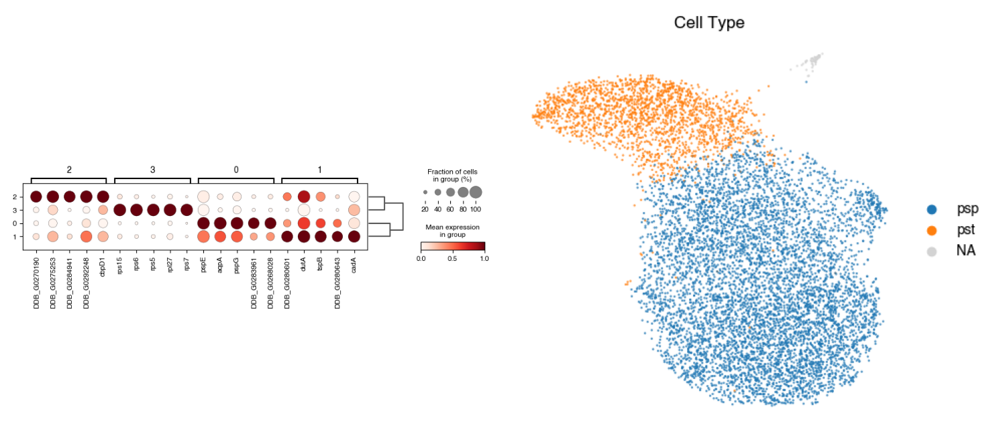

In [58]:
dotplot_img = mpimg.imread('figures/dotplot_geneplot_20hr.png')
heatmap_img = mpimg.imread('figures/X_uce_umapcelltype_20hr.png')
fig, axes = plt.subplots(1, 2, figsize=(15, 7))
axes[0].imshow(dotplot_img)
axes[0].axis('off')
axes[1].imshow(heatmap_img)
axes[1].axis('off')
plt.tight_layout()
plt.show()

In [59]:
result = adata_20hr_norm.uns["dea_leiden_2"]
groups = result['names'].dtype.names
top_genes = {group: result['names'][group][:5] for group in groups}
for group, genes in top_genes.items():
    print(f"Top genes for {group}: {list(genes)}")

Top genes for 0: ['pspE', 'aqpA', 'pspG', 'DDB_G0283961', 'DDB_G0268028']
Top genes for 1: ['DDB_G0280601', 'dutA', 'tspB', 'DDB_G0280643', 'cadA']
Top genes for 2: ['DDB_G0270190', 'DDB_G0275253', 'DDB_G0284941', 'DDB_G0292248', 'cbpD1']
Top genes for 3: ['rps15', 'rps6', 'rps5', 'rpl27', 'rps7']


The classification is as follows (leiden cluster: cell type):

In [60]:
print(annotation)

{'1': 'psp', '0': 'psp', '2': 'pst'}


## Classification across time points

Let's see how the cells were classified across the time points.

In [61]:
# Combine all unique categories from the annotation columns
all_categories = (
    adata_new.obs['12hr_annot'].cat.categories
    .union(adata_new.obs['16hr_annot'].cat.categories)
    .union(adata_new.obs['20hr_annot'].cat.categories)
)

# Ensure all annotation columns have the same categories
for col in ['12hr_annot', '16hr_annot', '20hr_annot']:
    adata_new.obs[col] = adata_new.obs[col].cat.set_categories(all_categories)

# Fill missing values in a cascading manner
adata_new.obs['cell_type'] = (
    adata_new.obs['12hr_annot']
    .fillna(adata_new.obs['16hr_annot'])
    .fillna(adata_new.obs['20hr_annot'])
).astype('category')

# #if not assigned, assign to unknown
# adata_new.obs['cell_type'] = adata_new.obs['cell_type'].cat.add_categories('Unassigned')
# adata_new.obs['cell_type'] = adata_new.obs['cell_type'].fillna('Unassigned')
print(adata_new.obs['cell_type'].value_counts())


cell_type
psp    20198
pst     7333
Name: count, dtype: int64


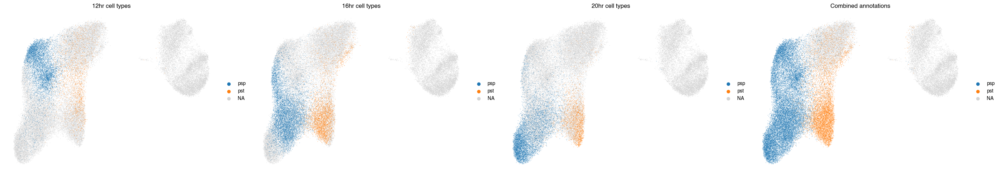

In [62]:


fig, ax = plt.subplots(1, 4, figsize=(28, 5))
sc.pl.embedding(
    adata_new,
    basis='X_uce_umap',
    color='12hr_annot',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0],
    show=False,
    title="12hr cell types",
)
sc.pl.embedding(
    adata_new,
    basis='X_uce_umap',
    color='16hr_annot',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1],
    show=False,
    title="16hr cell types",
)
sc.pl.embedding(
    adata_new,
    basis='X_uce_umap',
    color='20hr_annot',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[2],
    show=False,
    title="20hr cell types",
)
sc.pl.embedding(
    adata_new,
    basis='X_uce_umap',
    color='cell_type',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[3],
    show=False,
    title="Combined annotations",
)
plt.tight_layout()
plt.show()

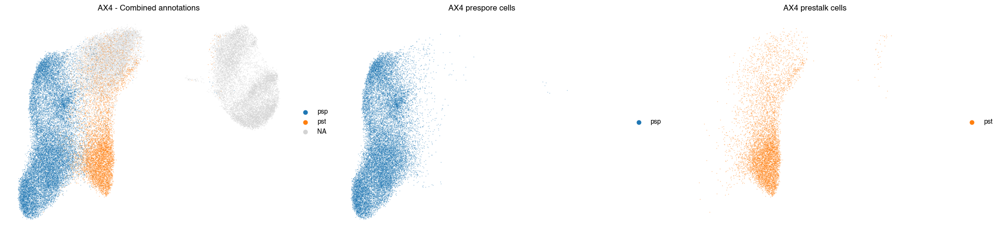

In [63]:
rows, cols = 1, 3
fig, ax = plt.subplots(rows, cols, figsize=(21, 5))
sc.pl.embedding(
    adata_new,
    basis='X_uce_umap',
    color='cell_type',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0],
    show=False,
    title="AX4 - Combined annotations",
)
adata_new_psp = adata_new[adata_new.obs['cell_type'] == "psp"]
adata_new_pst = adata_new[adata_new.obs['cell_type'] == "pst"]
sc.pl.embedding(
    adata_new_psp,
    basis='X_uce_umap',
    color='cell_type',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1],
    show=False,
    title="AX4 prespore cells",
)
sc.pl.embedding(
    adata_new_pst,
    basis='X_uce_umap',
    color='cell_type',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[2],
    show=False,
    title="AX4 prestalk cells",
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(rows):
    for j in range(cols):
        subplot = ax[i][j] if rows > 1 else ax[j]
        xlims.append(subplot.get_xlim())
        ylims.append(subplot.get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(rows):
    for j in range(cols):
        subplot = ax[i][j] if rows > 1 else ax[j]
        subplot.set_xlim(x_min, x_max)
        subplot.set_ylim(y_min, y_max)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

plt.tight_layout()
plt.savefig("../results/figures/AX4/AX4_cell_types.pdf", dpi=1200, backend="pgf")
plt.show()

In [64]:
adata_new.obs['X_uce_umap_x'] = adata_new.obsm['X_uce_umap'][:, 0]
adata_new.obs['X_uce_umap_y'] = adata_new.obsm['X_uce_umap'][:, 1]

In [65]:
adata_new.write(f"../data/processed/AX4.h5ad")

# acaA- strain

In [66]:
adata_acaA = sc.read(
    filename=f"../data/processed/acaA/acaA_00hr.h5ad"
)

adata_acaA.obs["time"] = time_points[0]
adata_acaA.obs["strain"] = "acaA"

for tp in time_points[1:]:
    adata_acaA_new = sc.read(
        filename=f"../data/processed/acaA/acaA_{tp}.h5ad"
    )
    adata_acaA_new.obs["time"] = tp
    adata_acaA_new.obs["strain"] = "acaA"
    adata_acaA = sc.concat([adata_acaA, adata_acaA_new], join='outer', merge='first')
    adata_acaA.var = adata_acaA.var[["gene_ids"]].copy()

adata_acaA.var_names_make_unique()
adata_acaA.obs_names_make_unique()

In [67]:
umap_adata_acaA = umap.UMAP(random_state=42)
umap_adata_acaA.fit(adata_acaA.obsm["X_uce"]) 
adata_acaA.obsm["X_uce_umap"] = umap_adata_acaA.transform(adata_acaA.obsm["X_uce"])

Let's repeat the same analysis for the acaA strain.

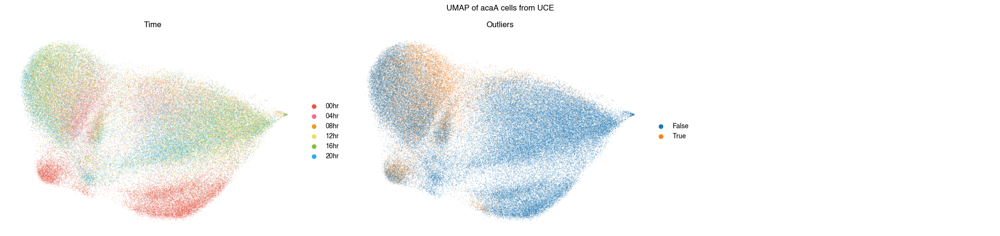

In [68]:
fig, ax = plt.subplots(1, 3, figsize=(21, 5))
sc.pl.embedding(
    adata_acaA,
    basis="X_uce_umap",
    color="time",
    size=5,
    alpha=0.3,
    palette=palette,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata_acaA,
    basis="X_uce_umap",
    color="outlier_all",
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Outliers",
)
ax[2].axis('off')
plt.suptitle("UMAP of acaA cells from UCE")
plt.tight_layout()
plt.show()

Let's filter out the outliers and see the UMAP again.

In [69]:
adata_acaA_outlier = adata_acaA[adata_acaA.obs['outlier_all'] == False]

In [70]:
umap_acaA_outlier = umap.UMAP(random_state=42)
umap_acaA_outlier.fit(adata_acaA_outlier.obsm["X_uce"]) 
adata_acaA_outlier.obsm["X_uce_umap"] = umap_acaA_outlier.transform(adata_acaA_outlier.obsm["X_uce"])

In [71]:
sc.pp.neighbors(adata_acaA_outlier, use_rep='X_uce')
sc.tl.leiden(adata_acaA_outlier, resolution=1)

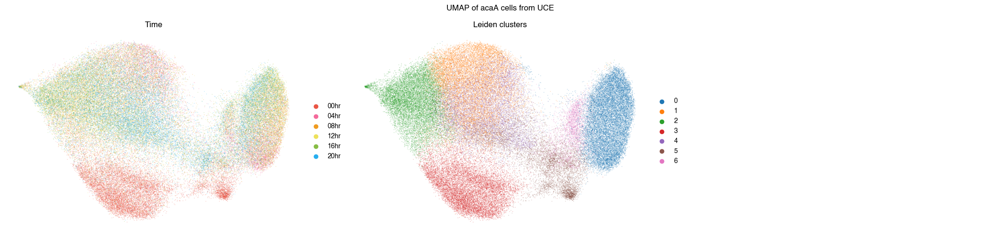

In [72]:
fig, ax = plt.subplots(1, 3, figsize=(21, 5))
sc.pl.embedding(
    adata_acaA_outlier,
    basis="X_uce_umap",
    color="time",
    size=5,
    alpha=0.3,
    palette=palette,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata_acaA_outlier,
    basis="X_uce_umap",
    color="leiden",
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters",
)
ax[2].axis('off')
plt.suptitle("UMAP of acaA cells from UCE")
plt.tight_layout()
plt.show()

Average counts per cell for cluster 0: 1455.7338
Average counts per cell for cluster 1: 12922.784
Average counts per cell for cluster 2: 23597.654
Average counts per cell for cluster 3: 14059.723
Average counts per cell for cluster 4: 14165.223
Average counts per cell for cluster 5: 6135.3457
Average counts per cell for cluster 6: 2890.801

Median counts per cell for cluster 0: 1273.0
Median counts per cell for cluster 1: 12012.5
Median counts per cell for cluster 2: 21695.0
Median counts per cell for cluster 3: 12412.0
Median counts per cell for cluster 4: 13075.0
Median counts per cell for cluster 5: 5418.0
Median counts per cell for cluster 6: 1449.0


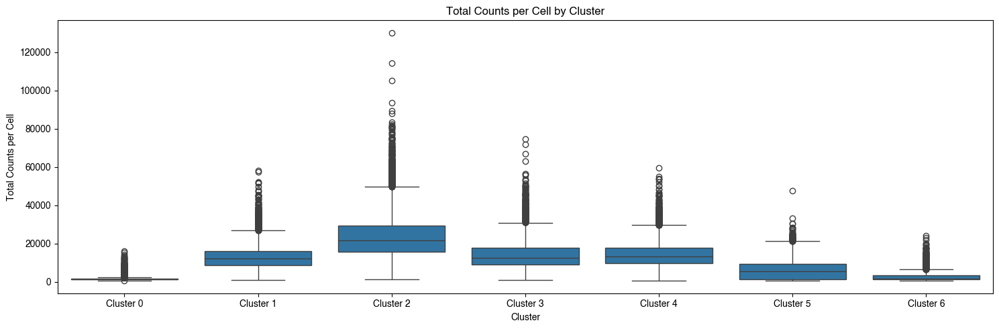

In [73]:
clusters_to_compare = range(0, len(adata_acaA_outlier.obs['leiden'].unique()))
data_frames = [get_counts_per_cell(adata_acaA_outlier, cluster) for cluster in clusters_to_compare]
print()
median_counts = {cluster: get_median_counts_per_cell(adata_acaA_outlier, cluster) for cluster in clusters_to_compare}
combined_df = pd.concat(data_frames)

plt.figure(figsize=(15, 5))
sns.boxplot(data=combined_df, x='Cluster', y='Total Counts')
plt.title("Total Counts per Cell by Cluster")
plt.ylabel("Total Counts per Cell")
plt.xlabel("Cluster")
plt.tight_layout()
plt.show()

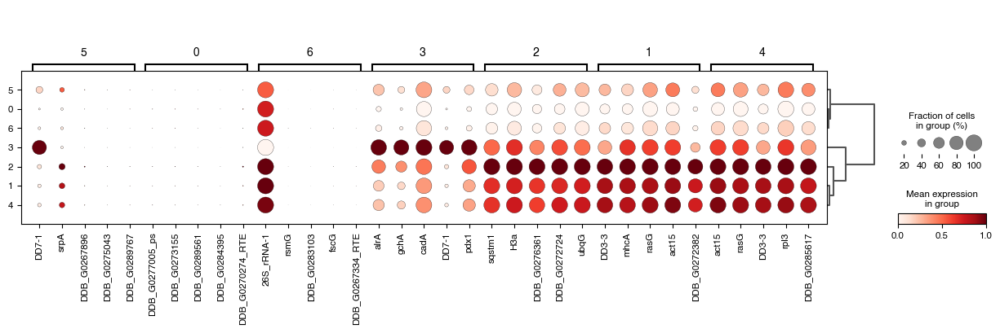

In [74]:
adata_acaA_outlier_norm = adata_acaA_outlier.copy()
adata_acaA_outlier_norm.X = np.log1p(adata_acaA_outlier_norm.X)

sc.tl.rank_genes_groups(
    adata_acaA_outlier_norm, groupby="leiden", method="wilcoxon", key_added="dea_leiden_2"
)
sc.pl.rank_genes_groups_dotplot(
    adata_acaA_outlier_norm, groupby="leiden", standard_scale="var", n_genes=5, key="dea_leiden_2"
)

Let's filter out clusters 0, 5 and 6 as their read counts are much lower than those of the other clusters, and then visualize the data again.

In [75]:
mask = ~adata_acaA_outlier.obs['leiden'].isin(['0', '5', '6'])
adata_acaA_new = adata_acaA_outlier[mask].copy()
adata_acaA_new.obs_names_make_unique()

In [76]:
umap_acaA_new = umap.UMAP(random_state=42)
umap_acaA_new.fit(adata_acaA_new.obsm["X_uce"]) 
adata_acaA_new.obsm["X_uce_umap"] = umap_acaA_new.transform(adata_acaA_new.obsm["X_uce"])

In [77]:
adata_acaA_new = assign_markers(adata_acaA_new, time_points, neon_all=True)

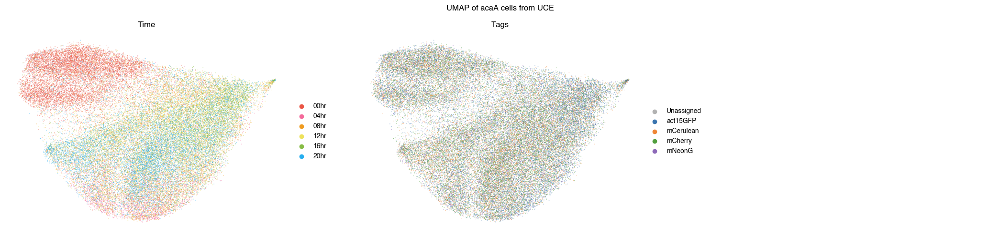

In [78]:
rows, cols = 1, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 5))
sc.pl.embedding(
    adata_acaA_new,
    basis="X_uce_umap",
    color="time",
    size=5,
    alpha=0.5,
    palette=palette,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata_acaA_new,
    basis="X_uce_umap",
    color="marker",
    palette=replicate_palette,
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Tags",
)
ax[2].axis('off')

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

plt.suptitle("UMAP of acaA cells from UCE")
plt.tight_layout()
plt.savefig("../results/figures/acaA/acaA.pdf", dpi=1200, backend="pgf")
plt.show()

In [79]:
adata_acaA_new_gfp = adata_acaA_new[adata_acaA_new.obs["marker"] == "act15GFP"]
adata_acaA_new_mcerulean = adata_acaA_new[adata_acaA_new.obs["marker"] == "mCerulean"]
adata_acaA_new_mcherry = adata_acaA_new[adata_acaA_new.obs["marker"] == "mCherry"]
adata_acaA_new_mneongreen = adata_acaA_new[adata_acaA_new.obs["marker"] == "mNeonG"]

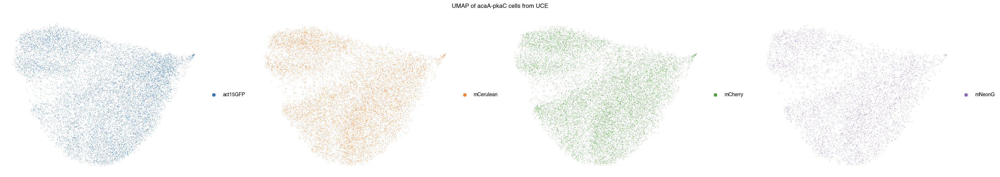

In [80]:
rows, cols = 1, 4
fig, ax = plt.subplots(rows, cols, figsize=(28, 5))

# Plot each embedding
sc.pl.embedding(
    adata_acaA_new_gfp,
    basis='X_uce_umap',
    color='marker',
    palette=replicate_palette,
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[0],
    show=False,
    title="",
)
sc.pl.embedding(
    adata_acaA_new_mcerulean,
    basis='X_uce_umap',
    color='marker',
    palette=replicate_palette,
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[1],
    show=False,
    title="",
)
sc.pl.embedding(
    adata_acaA_new_mcherry,
    basis='X_uce_umap',
    color='marker',
    palette=replicate_palette,
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[2],
    show=False,
    title="",
)
sc.pl.embedding(
    adata_acaA_new_mneongreen,
    basis='X_uce_umap',
    color='marker',
    size=5,
    palette=replicate_palette,
    alpha=0.6,
    frameon=False,
    ax=ax[3],
    show=False,
    title="",
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(cols):
    xlims.append(ax[i].get_xlim())
    ylims.append(ax[i].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(cols):
    ax[i].set_xlim(x_min, x_max)
    ax[i].set_ylim(y_min, y_max)
    
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

# Add title and adjust layout
plt.suptitle("UMAP of acaA-pkaC cells from UCE")
plt.tight_layout()
plt.savefig("../results/figures/acaA/acaA_replicates.pdf", dpi=1200, backend="pgf")
plt.show()

In [81]:
adata_acaA_new_00hr = adata_acaA_new[adata_acaA_new.obs["time"] == "00hr"]
adata_acaA_new_04hr = adata_acaA_new[adata_acaA_new.obs["time"] == "04hr"]
adata_acaA_new_08hr = adata_acaA_new[adata_acaA_new.obs["time"] == "08hr"]
adata_acaA_new_12hr = adata_acaA_new[adata_acaA_new.obs["time"] == "12hr"]
adata_acaA_new_16hr = adata_acaA_new[adata_acaA_new.obs["time"] == "16hr"]
adata_acaA_new_20hr = adata_acaA_new[adata_acaA_new.obs["time"] == "20hr"]

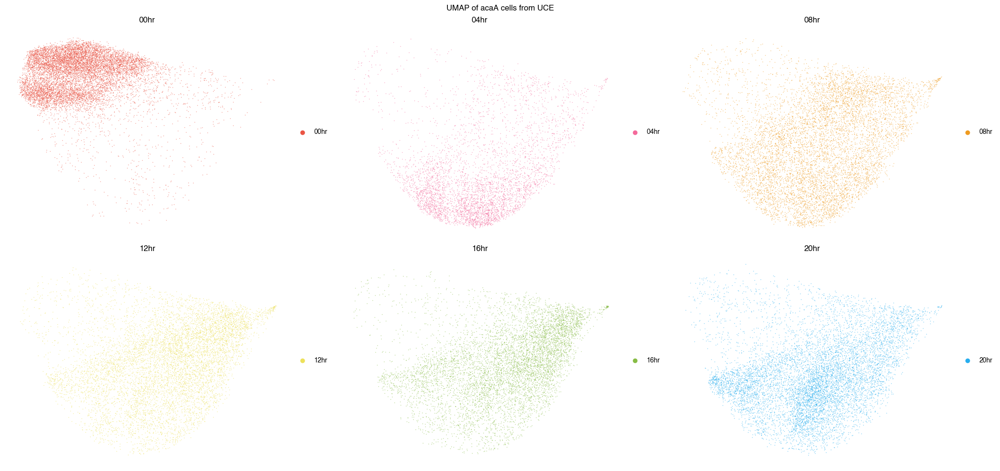

In [82]:
rows, cols = 2, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 10))

# Plot each embedding
sc.pl.embedding(
    adata_acaA_new_00hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="00hr",
)
sc.pl.embedding(
    adata_acaA_new_04hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="04hr",
)
sc.pl.embedding(
    adata_acaA_new_08hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="08hr",
)
sc.pl.embedding(
    adata_acaA_new_12hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[1][0],
    show=False,
    title="12hr",
)
sc.pl.embedding(
    adata_acaA_new_16hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[1][1],
    show=False,
    title="16hr",
)
sc.pl.embedding(
    adata_acaA_new_20hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.6,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="20hr",
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(2):
    for j in range(3):
        xlims.append(ax[i][j].get_xlim())
        ylims.append(ax[i][j].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(2):
    for j in range(3):
        ax[i][j].set_xlim(x_min, x_max)
        ax[i][j].set_ylim(y_min, y_max)
        
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

# Add title and adjust layout
plt.suptitle("UMAP of acaA cells from UCE")
plt.tight_layout()
plt.savefig("../results/figures/acaA/acaA_time.pdf", dpi=1200, backend="pgf")
plt.show()



In [83]:
adata_acaA_new.obs['X_uce_umap_x'] = adata_acaA_new.obsm['X_uce_umap'][:, 0]
adata_acaA_new.obs['X_uce_umap_y'] = adata_acaA_new.obsm['X_uce_umap'][:, 1]

In [84]:
 
filter_ratio = adata_acaA_new.obs['time'].value_counts() / adata_acaA.obs['time'].value_counts()
print("Number of cells per time point before filtering:")
print(adata_acaA.obs['time'].value_counts().sort_index())
print()
print("Number of cells per time point after filtering:")
print(adata_acaA_new.obs['time'].value_counts().sort_index())
print()
print("Percentage of cells kept per time point:")
print(filter_ratio * 100)

Number of cells per time point before filtering:
time
00hr    15813
04hr    11951
08hr    15341
12hr    15186
16hr    15536
20hr    17552
Name: count, dtype: int64

Number of cells per time point after filtering:
time
00hr    10593
04hr     4499
08hr     8040
12hr     7640
16hr     7069
20hr     8908
Name: count, dtype: int64

Percentage of cells kept per time point:
time
00hr    66.989186
04hr    37.645385
08hr    52.408578
12hr    50.309496
16hr    45.500772
20hr    50.752051
Name: count, dtype: float64


In [85]:
adata_acaA_new_norm = adata_acaA_new.copy()
adata_acaA_new_norm.X = np.log1p(adata_acaA_new_norm.X)

In [86]:
for key in ['noagg_ripple_up', 'ripple_lag_up', 'lag_tag_up', 'tag_tip_up', 'tip_slug_up', 'slug_Mhat_up', 'Mhat_cul_up', 'cul_FB_up']:
    valid_genes = [gene for gene in marker_genes_ids[key] if gene in adata_acaA_new_norm.var["gene_ids"].values]
    mask = adata_acaA_new_norm.var["gene_ids"].isin(marker_genes_ids[key])
    if len(valid_genes) == 0:
        continue
    subset_data = adata_acaA_new_norm[:, mask].X
    adata_acaA_new_norm.obs[key] = subset_data.mean(axis=1)

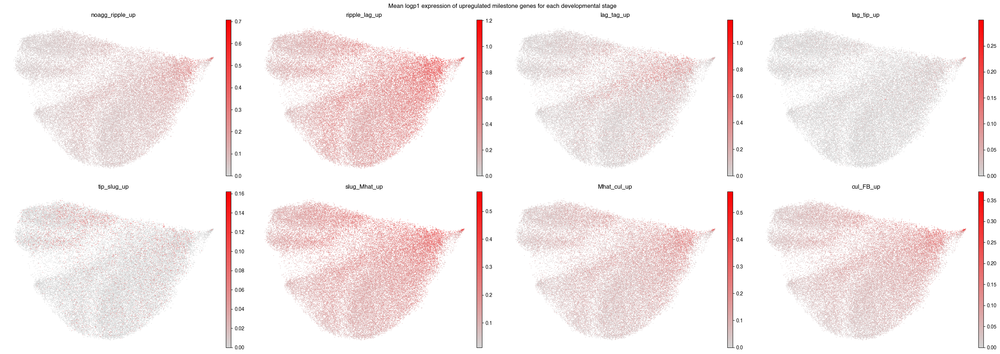

In [87]:
rows, cols = 2, 4

fig, ax = plt.subplots(rows, cols, figsize=(28, 10))
grey_to_red = LinearSegmentedColormap.from_list("GreyToRed", ["lightgrey", "red"])
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='noagg_ripple_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="noagg_ripple_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='ripple_lag_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="ripple_lag_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='lag_tag_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="lag_tag_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='tag_tip_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][3],
    show=False,
    title="tag_tip_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='tip_slug_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][0],
    show=False,
    title="tip_slug_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='slug_Mhat_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][1],
    show=False,
    title="slug_Mhat_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='Mhat_cul_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="Mhat_cul_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='cul_FB_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][3],
    show=False,
    title="cul_FB_up",
    color_map=grey_to_red,
)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)
            
plt.suptitle("Mean logp1 expression of upregulated milestone genes for each developmental stage")
plt.tight_layout()
plt.savefig("../results/figures/acaA/acaA_milestones_up.pdf", dpi=1200, backend="pgf")
plt.show()

In [88]:
for key in ['noagg_ripple_down', 'ripple_lag_down', 'lag_tag_down', 'tag_tip_down', 'tip_slug_down', 'slug_Mhat_down', 'Mhat_cul_down', 'cul_FB_down']:
    valid_genes = [gene for gene in marker_genes_ids[key] if gene in adata_acaA_new_norm.var["gene_ids"].values]
    mask = adata_acaA_new_norm.var["gene_ids"].isin(marker_genes_ids[key])
    if len(valid_genes) == 0:
        continue
    subset_data = adata_acaA_new_norm[:, mask].X
    adata_acaA_new_norm.obs[key] = subset_data.mean(axis=1)


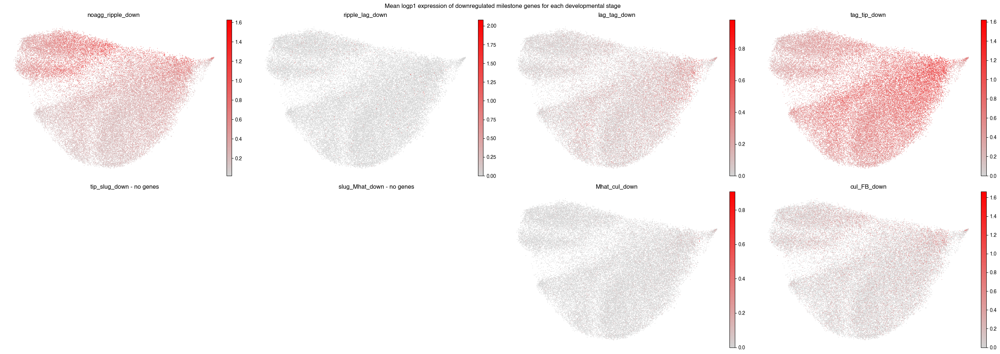

In [89]:
rows, cols = 2, 4

fig, ax = plt.subplots(rows, cols, figsize=(28, 10))
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='noagg_ripple_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="noagg_ripple_down",
    color_map=grey_to_red,
    
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='ripple_lag_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="ripple_lag_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='lag_tag_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="lag_tag_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='tag_tip_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][3],
    show=False,
    title="tag_tip_down",
    color_map=grey_to_red,
)
ax[1][0].axis('off')
ax[1][0].set_title("tip_slug_down - no genes")
ax[1][1].axis('off')
ax[1][1].set_title("slug_Mhat_down - no genes")
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='Mhat_cul_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="Mhat_cul_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_new_norm,
    basis='X_uce_umap',
    color='cul_FB_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][3],
    show=False,
    title="cul_FB_down",
    color_map=grey_to_red,
)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

plt.suptitle("Mean logp1 expression of downregulated milestone genes for each developmental stage")
plt.tight_layout()
plt.savefig("../results/figures/acaA/acaA_milestones_down.pdf", dpi=1200, backend="pgf")
plt.show()

In [90]:
adata_acaA_new.write(f"../data/processed/acaA.h5ad")

In [91]:
adata_all_strains = sc.concat([adata_new, adata_acaA_new], join='outer')

In [92]:
adata_all_strains.obs_names_make_unique()

Now let's project the acaA embeddings onto AX4 UMAP space to compare the two strains.

In [93]:
adata_all_strains.obsm["X_uce_umap_AX4"] = umap_adata_new.transform(adata_all_strains.obsm["X_uce"])

In [94]:
adata_all_strains.obs['X_uce_umap_AX4_x'] = adata_all_strains.obsm['X_uce_umap_AX4'][:, 0]
adata_all_strains.obs['X_uce_umap_AX4_y'] = adata_all_strains.obsm['X_uce_umap_AX4'][:, 1]

In [95]:
adata_subset_ax4 = adata_all_strains[adata_all_strains.obs["strain"] == "AX4"]
adata_subset_acaA = adata_all_strains[adata_all_strains.obs["strain"] == "acaA"]

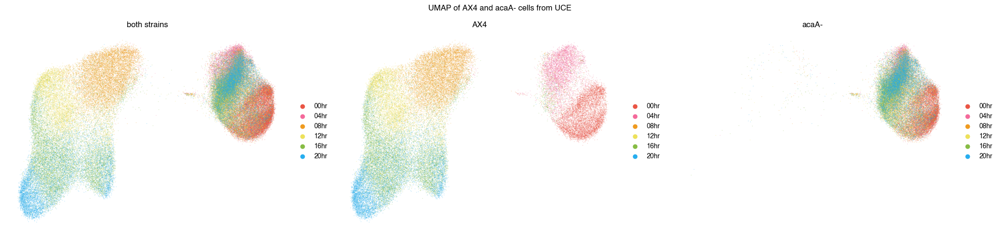

In [96]:
rows, cols = 1, 3
fig, ax = plt.subplots(rows, cols, figsize=(21, 5))
sc.pl.embedding(
    adata_all_strains,
    basis="X_uce_umap_AX4",
    color="time",
    alpha=0.3,
    palette=palette,
    size=5,
    frameon=False,
    title="both strains",
    ax=ax[0],
    show=False,
)
sc.pl.embedding(
    adata_subset_ax4,
    basis="X_uce_umap_AX4",
    color="time",
    alpha=0.3,
    palette=palette,
    size=5,
    frameon=False,
    title="AX4",
    ax=ax[1],
    show=False,
)
sc.pl.embedding(
    adata_subset_acaA,
    basis="X_uce_umap_AX4",
    color="time",
    palette=palette,
    alpha=0.3,
    size=5,
    frameon=False,
    title="acaA-",
    ax=ax[2],
    show=False,
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(3):
    xlims.append(ax[i].get_xlim())
    ylims.append(ax[i].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(3):
    ax[i].set_xlim(x_min, x_max)
    ax[i].set_ylim(y_min, y_max)
    
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)
    
plt.suptitle("UMAP of AX4 and acaA- cells from UCE")
plt.tight_layout()
plt.savefig("../results/figures/acaA/acaA_ontoAX4.pdf", dpi=1200, backend="pgf")
plt.show()

In [97]:
adata_acaA_new_00hr = adata_subset_acaA[adata_subset_acaA.obs["time"] == "00hr"]
adata_acaA_new_04hr = adata_subset_acaA[adata_subset_acaA.obs["time"] == "04hr"]
adata_acaA_new_08hr = adata_subset_acaA[adata_subset_acaA.obs["time"] == "08hr"]
adata_acaA_new_12hr = adata_subset_acaA[adata_subset_acaA.obs["time"] == "12hr"]
adata_acaA_new_16hr = adata_subset_acaA[adata_subset_acaA.obs["time"] == "16hr"]
adata_acaA_new_20hr = adata_subset_acaA[adata_subset_acaA.obs["time"] == "20hr"]

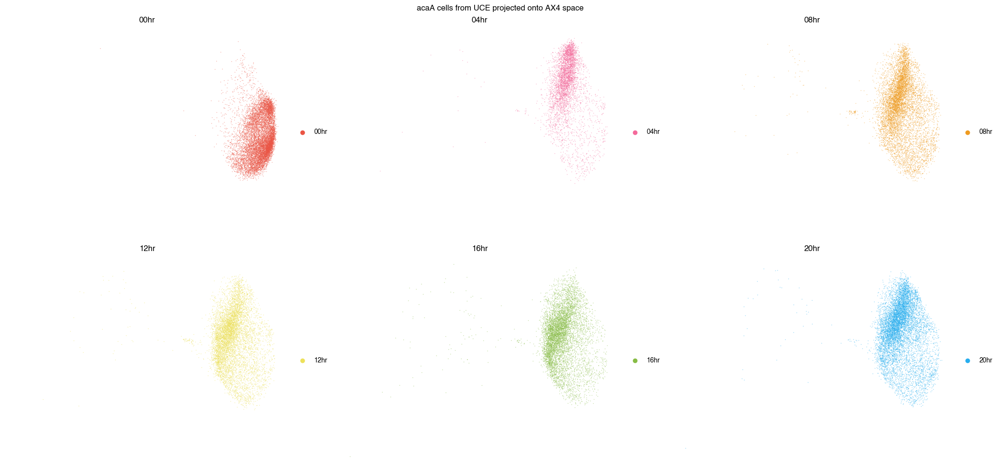

In [98]:
rows, cols = 2, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 10))

# Plot each embedding
sc.pl.embedding(
    adata_acaA_new_00hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="00hr",
)
sc.pl.embedding(
    adata_acaA_new_04hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="04hr",
)
sc.pl.embedding(
    adata_acaA_new_08hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="08hr",
)
sc.pl.embedding(
    adata_acaA_new_12hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1][0],
    show=False,
    title="12hr",
)
sc.pl.embedding(
    adata_acaA_new_16hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1][1],
    show=False,
    title="16hr",
)
sc.pl.embedding(
    adata_acaA_new_20hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="20hr",
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(2):
    for j in range(3):
        xlims.append(ax[i][j].get_xlim())
        ylims.append(ax[i][j].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(2):
    for j in range(3):
        ax[i][j].set_xlim(x_min, x_max)
        ax[i][j].set_ylim(y_min, y_max)
        
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

# Add title and adjust layout
plt.suptitle("acaA cells from UCE projected onto AX4 space")
plt.tight_layout()
plt.savefig("../results/figures/acaA/acaA_time_ontoAX4.pdf", dpi=1200, backend="pgf")
plt.show()

As expected, the acaA- strain's development halts at 4 hours and remains on the left side of the plot.

In [99]:
def get_memory_usage():
    vars_in_scope = {name: obj for name, obj in globals().items() if not name.startswith('__')}
    mem_usage = {}

    for name, obj in vars_in_scope.items():
        try:
            mem_usage[name] = asizeof.asizeof(obj)  # Try to get full memory usage
        except Exception:
            try:
                mem_usage[name] = sys.getsizeof(obj)  # Fallback to sys.getsizeof()
            except Exception:
                mem_usage[name] = None  # If it still fails, mark as None

    # Convert to DataFrame for sorting
    df = pd.DataFrame(mem_usage.items(), columns=['Variable', 'Size (Bytes)'])
    df = df.dropna().sort_values(by="Size (Bytes)", ascending=False)

    return df

# Display variables sorted by memory usage
mem_df = get_memory_usage()

In [100]:
del adata_all_strains
del adata_acaA
del adata
del adata_outlier
del adata_new_norm
del adata_acaA_new
del adata_acaA_outlier_norm
del adata_acaA_outlier
del adata_12hr
del adata_16hr
del adata_20hr
del adata_12hr_norm
del adata_16hr_norm
del adata_20hr_norm
gc.collect() 

137985

# acaA- pkaC- strain

In [101]:
adata_acaA_pkaC = sc.read(
    filename=f"../data/processed/acaA_pkaC/acaA_pkaC_00hr.h5ad"
)

In [102]:
adata_acaA_pkaC.obs["time"] = time_points[0]
adata_acaA_pkaC.obs["strain"] = "acaA_pkaC"

for tp in time_points[1:]:
    adata_acaA_pkaC_new = sc.read(
        filename=f"../data/processed/acaA_pkaC/acaA_pkaC_{tp}.h5ad"
    )
    adata_acaA_pkaC_new.obs["time"] = tp
    adata_acaA_pkaC_new.obs["strain"] = "acaA_pkaC"
    adata_acaA_pkaC = sc.concat([adata_acaA_pkaC, adata_acaA_pkaC_new], join='outer', merge="first")
    adata_acaA_pkaC.var = adata_acaA_pkaC.var[["gene_ids"]].copy()
    
adata_acaA_pkaC.var_names_make_unique()
adata_acaA_pkaC.obs_names_make_unique()

In [103]:
umap_adata_acaA_pkaC = umap.UMAP(random_state=42)
umap_adata_acaA_pkaC.fit(adata_acaA_pkaC.obsm["X_uce"]) 
adata_acaA_pkaC.obsm["X_uce_umap"] = umap_adata_acaA_pkaC.transform(adata_acaA_pkaC.obsm["X_uce"])

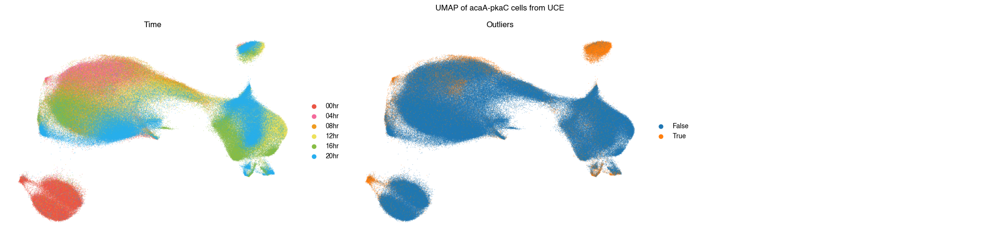

In [104]:
fig, ax = plt.subplots(1, 3, figsize=(21, 5))
sc.pl.embedding(
    adata_acaA_pkaC,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    palette=palette,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata_acaA_pkaC,
    basis='X_uce_umap',
    color='outlier_all',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Outliers",
)
ax[2].axis('off')
plt.suptitle("UMAP of acaA-pkaC cells from UCE")
plt.tight_layout()
plt.show()

Let's filter out the outliers and see the UMAP again.

In [105]:
adata_acaA_pkaC_outlier = adata_acaA_pkaC[adata_acaA_pkaC.obs['outlier_all'] == False]
umap_adata_acaA_pkaC_outlier = umap.UMAP(random_state=42)
umap_adata_acaA_pkaC_outlier.fit(adata_acaA_pkaC_outlier.obsm["X_uce"]) 
adata_acaA_pkaC_outlier.obsm["X_uce_umap"] = umap_adata_acaA_pkaC_outlier.transform(adata_acaA_pkaC_outlier.obsm["X_uce"])

In [106]:
sc.pp.neighbors(adata_acaA_pkaC_outlier, use_rep='X_uce')
sc.tl.leiden(adata_acaA_pkaC_outlier, resolution=0.5)

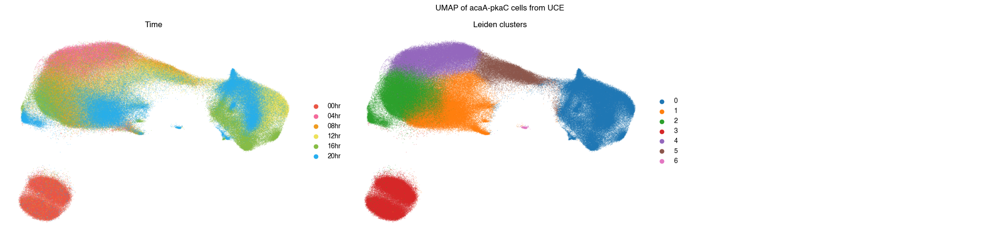

In [107]:
fig, ax = plt.subplots(1, 3, figsize=(21, 5))
sc.pl.embedding(
    adata_acaA_pkaC_outlier,
    basis='X_uce_umap',
    color='time',
    palette=palette,
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata_acaA_pkaC_outlier,
    basis='X_uce_umap',
    color='leiden',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters", 
)
ax[2].axis('off')
plt.suptitle("UMAP of acaA-pkaC cells from UCE")
plt.tight_layout()
plt.show()

Average counts per cell for cluster 0: 4593.8335
Average counts per cell for cluster 1: 7846.3784
Average counts per cell for cluster 2: 5246.4014
Average counts per cell for cluster 3: 10604.633
Average counts per cell for cluster 4: 3379.5886
Average counts per cell for cluster 5: 5206.2954
Average counts per cell for cluster 6: 654.1195

Median counts per cell for cluster 0: 3710.0
Median counts per cell for cluster 1: 7421.0
Median counts per cell for cluster 2: 4815.0
Median counts per cell for cluster 3: 10202.0
Median counts per cell for cluster 4: 3049.0
Median counts per cell for cluster 5: 4343.0
Median counts per cell for cluster 6: 605.0


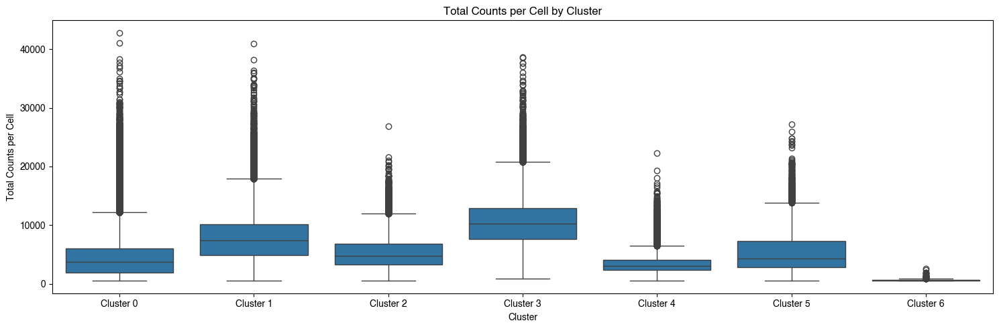

In [108]:
clusters_to_compare = range(0, len(adata_acaA_pkaC_outlier.obs['leiden'].unique()))
data_frames = [get_counts_per_cell(adata_acaA_pkaC_outlier, cluster) for cluster in clusters_to_compare]
print()
median_counts = {cluster: get_median_counts_per_cell(adata_acaA_pkaC_outlier, cluster) for cluster in clusters_to_compare}
combined_df = pd.concat(data_frames)

plt.figure(figsize=(15, 5))
sns.boxplot(data=combined_df, x='Cluster', y='Total Counts')
plt.title("Total Counts per Cell by Cluster")
plt.ylabel("Total Counts per Cell")
plt.xlabel("Cluster")
plt.tight_layout()
plt.show()

The only cluster with significantly lower read counts is cluster 6, which is really small. Let's filter it out and visualize the data again.

In [109]:
mask = ~adata_acaA_pkaC_outlier.obs['leiden'].isin(['6'])
adata_acaA_pkaC_new = adata_acaA_pkaC_outlier[mask].copy()
adata_acaA_pkaC_new.obs_names_make_unique()

In [110]:
filter_ratio = adata_acaA_pkaC_new.obs['time'].value_counts() / adata_acaA_pkaC.obs['time'].value_counts()
print("Number of cells per time point before filtering:")
print(adata_acaA_pkaC.obs['time'].value_counts().sort_index())
print()
print("Number of cells per time point after filtering:")
print(adata_acaA_pkaC_new.obs['time'].value_counts().sort_index())
print()
print("Percentage of cells kept per time point:")
print(filter_ratio * 100)

Number of cells per time point before filtering:
time
00hr    62702
04hr    63529
08hr    70513
12hr    73399
16hr    61236
20hr    67191
Name: count, dtype: int64

Number of cells per time point after filtering:
time
00hr    54666
04hr    54711
08hr    63231
12hr    62114
16hr    54937
20hr    59546
Name: count, dtype: int64

Percentage of cells kept per time point:
time
00hr    87.183822
04hr    86.119725
08hr    89.672826
12hr    84.625131
16hr    89.713567
20hr    88.621988
Name: count, dtype: float64


In [111]:
del adata_acaA_pkaC
del adata_acaA_pkaC_outlier
gc.collect()

8133

In [112]:
adata_acaA_pkaC_new.obsm["X_uce_umap_AX4"] = umap_adata_new.transform(adata_acaA_pkaC_new.obsm["X_uce"])

In [113]:
umap_adata_acaA_pkaC_new = umap.UMAP(random_state=42)
umap_adata_acaA_pkaC_new.fit(adata_acaA_pkaC_new.obsm["X_uce"]) 
adata_acaA_pkaC_new.obsm["X_uce_umap"] = umap_adata_acaA_pkaC_new.transform(adata_acaA_pkaC_new.obsm["X_uce"])

In [114]:
adata_new.obsm["X_uce_umap_acaA_pkaC"] = umap_adata_acaA_pkaC_new.transform(adata_new.obsm["X_uce"])

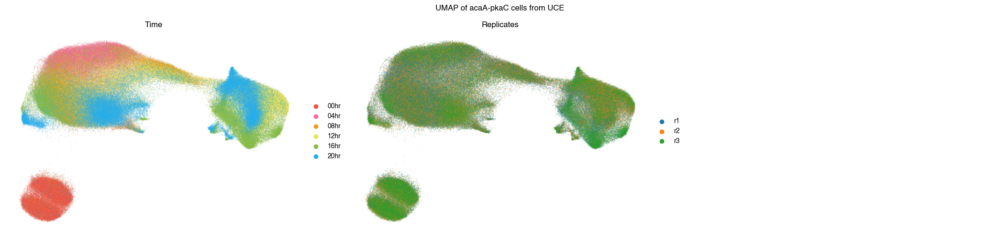

In [115]:
rows, cols = 1, 3
fig, ax = plt.subplots(rows, cols, figsize=(21, 5))
sc.pl.embedding(
    adata_acaA_pkaC_new,
    basis='X_uce_umap',
    color='time',
    palette=palette,
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Time",
)
sc.pl.embedding(
    adata_acaA_pkaC_new,
    basis='X_uce_umap',
    color='marker',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Replicates",
)
ax[2].axis('off')

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)
            
plt.suptitle("UMAP of acaA-pkaC cells from UCE")
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC.pdf", dpi=1200, backend="pgf")
plt.show()

Let's visualize each time point separately to see if the development for the acaA- pkaC strain.

In [116]:
adata_acaA_pkaC_new_00hr = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["time"] == "00hr"]
adata_acaA_pkaC_new_04hr = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["time"] == "04hr"]
adata_acaA_pkaC_new_08hr = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["time"] == "08hr"]
adata_acaA_pkaC_new_12hr = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["time"] == "12hr"]
adata_acaA_pkaC_new_16hr = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["time"] == "16hr"]
adata_acaA_pkaC_new_20hr = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["time"] == "20hr"]

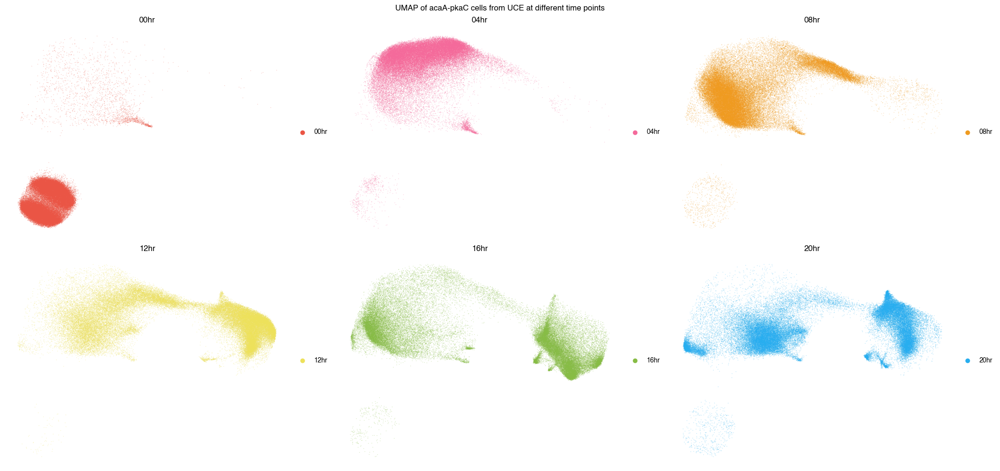

In [117]:
rows, cols = 2, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 10))

sc.pl.embedding(
    adata_acaA_pkaC_new_00hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="00hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_04hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="04hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_08hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="08hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_12hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1][0],
    show=False,
    title="12hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_16hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1][1],
    show=False,
    title="16hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_20hr,
    basis='X_uce_umap',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="20hr",
)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

plt.suptitle("UMAP of acaA-pkaC cells from UCE at different time points")
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC_time.pdf", dpi=1200, backend="pgf")
plt.show()

In [118]:
adata_new_00hr = adata_new[adata_new.obs["time"] == "00hr"]
adata_new_04hr = adata_new[adata_new.obs["time"] == "04hr"]
adata_new_08hr = adata_new[adata_new.obs["time"] == "08hr"]
adata_new_12hr = adata_new[adata_new.obs["time"] == "12hr"]
adata_new_16hr = adata_new[adata_new.obs["time"] == "16hr"]
adata_new_20hr = adata_new[adata_new.obs["time"] == "20hr"]

Let's also seperate it by replicates to see if there are any differences between them.

In [119]:
adata_acaA_pkaC_new_r1 = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["marker"] == "r1"]
adata_acaA_pkaC_new_r2 = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["marker"] == "r2"]
adata_acaA_pkaC_new_r3 = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["marker"] == "r3"]

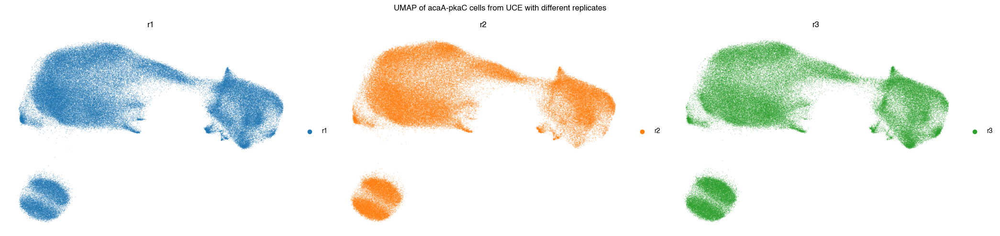

In [120]:
rows, cols = 1, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 5))

sc.pl.embedding(
    adata_acaA_pkaC_new_r1,
    basis='X_uce_umap',
    color='marker',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0],
    show=False,
    title="r1",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_r2,
    basis='X_uce_umap',
    color='marker',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="r2",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_r3,
    basis='X_uce_umap',
    color='marker',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[2],
    show=False,
    title="r3",
)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

plt.suptitle("UMAP of acaA-pkaC cells from UCE with different replicates")
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC_replicates.pdf", dpi=1200, backend="pgf")
plt.show()


Let's also see the expression of milestone genes that are upregulated or downregulated in each developmental stage.

In [121]:
adata_acaA_pkaC_new_norm = adata_acaA_pkaC_new.copy()
adata_acaA_pkaC_new_norm.X = np.log1p(adata_acaA_pkaC_new_norm.X)

In [122]:
for key in ['noagg_ripple_up', 'ripple_lag_up', 'lag_tag_up', 'tag_tip_up', 'tip_slug_up', 'slug_Mhat_up', 'Mhat_cul_up', 'cul_FB_up']:
    valid_genes = [gene for gene in marker_genes_ids[key] if gene in adata_acaA_pkaC_new_norm.var["gene_ids"].values]
    mask = adata_acaA_pkaC_new_norm.var["gene_ids"].isin(marker_genes_ids[key])
    if len(valid_genes) == 0:
        continue
    subset_data = adata_acaA_pkaC_new_norm[:, mask].X
    adata_acaA_pkaC_new_norm.obs[key] = subset_data.mean(axis=1)

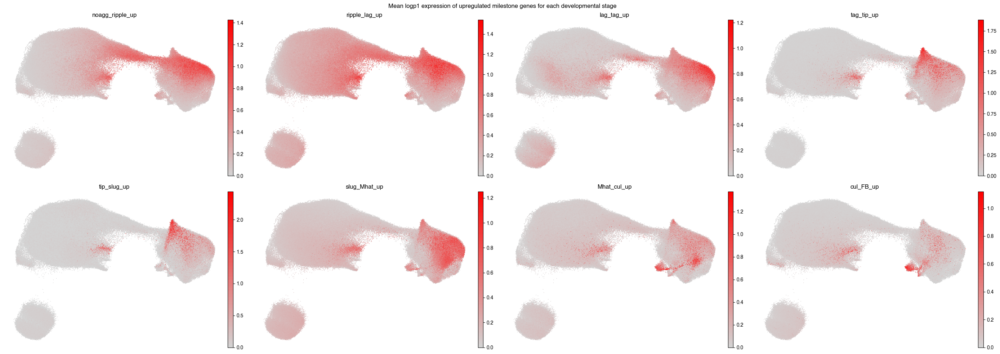

In [123]:
rows, cols = 2, 4

fig, ax = plt.subplots(rows, cols, figsize=(28, 10))
grey_to_red = LinearSegmentedColormap.from_list("GreyToRed", ["lightgrey", "red"])
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='noagg_ripple_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="noagg_ripple_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='ripple_lag_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="ripple_lag_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='lag_tag_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="lag_tag_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='tag_tip_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][3],
    show=False,
    title="tag_tip_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='tip_slug_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][0],
    show=False,
    title="tip_slug_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='slug_Mhat_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][1],
    show=False,
    title="slug_Mhat_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='Mhat_cul_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="Mhat_cul_up",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='cul_FB_up',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][3],
    show=False,
    title="cul_FB_up",
    color_map=grey_to_red,
)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)
            
plt.suptitle("Mean logp1 expression of upregulated milestone genes for each developmental stage")
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC_milestones_up.pdf", dpi=1200, backend="pgf")
plt.show()

In [124]:
for key in ['noagg_ripple_down', 'ripple_lag_down', 'lag_tag_down', 'tag_tip_down', 'tip_slug_down', 'slug_Mhat_down', 'Mhat_cul_down', 'cul_FB_down']:
    valid_genes = [gene for gene in marker_genes_ids[key] if gene in adata_acaA_pkaC_new_norm.var["gene_ids"].values]
    mask = adata_acaA_pkaC_new_norm.var["gene_ids"].isin(marker_genes_ids[key])
    if len(valid_genes) == 0:
        continue
    subset_data = adata_acaA_pkaC_new_norm[:, mask].X
    adata_acaA_pkaC_new_norm.obs[key] = subset_data.mean(axis=1)


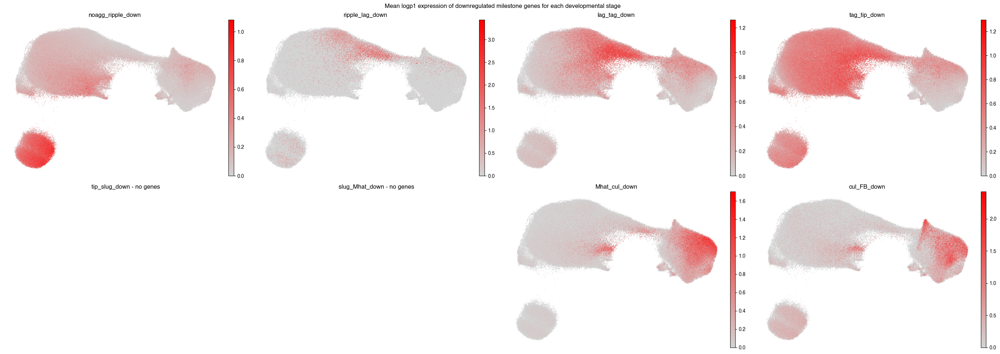

In [125]:
rows, cols = 2, 4
fig, ax = plt.subplots(rows, cols, figsize=(28, 10))
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='noagg_ripple_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="noagg_ripple_down",
    color_map=grey_to_red,
    
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='ripple_lag_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="ripple_lag_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='lag_tag_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="lag_tag_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='tag_tip_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[0][3],
    show=False,
    title="tag_tip_down",
    color_map=grey_to_red,
)
ax[1][0].axis('off')
ax[1][0].set_title("tip_slug_down - no genes")
ax[1][1].axis('off')
ax[1][1].set_title("slug_Mhat_down - no genes")
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='Mhat_cul_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="Mhat_cul_down",
    color_map=grey_to_red,
)
sc.pl.embedding(
    adata_acaA_pkaC_new_norm,
    basis='X_uce_umap',
    color='cul_FB_down',
    size=5,
    alpha=1,
    frameon=False,
    ax=ax[1][3],
    show=False,
    title="cul_FB_down",
    color_map=grey_to_red,
)

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

plt.suptitle("Mean logp1 expression of downregulated milestone genes for each developmental stage")
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC_milestones_down.pdf", dpi=1200, backend="pgf")
plt.show()

Now let's project the acaA- pkaC embeddings onto AX4 UMAP space to compare the two strains.

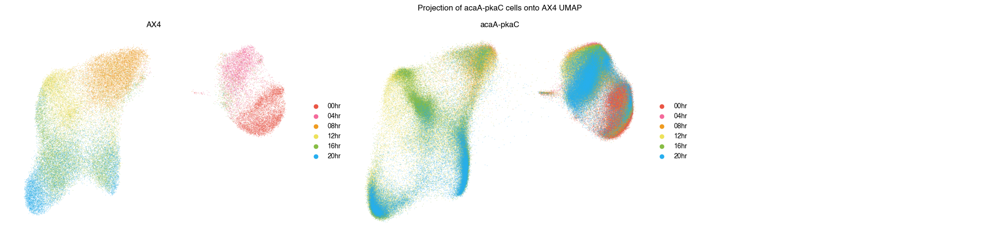

In [126]:
rows, cols = 1, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 5))

sc.pl.embedding(
    adata_new,
    basis='X_uce_umap',
    color='time',
    size=5,
    palette=palette,
    alpha=0.3,
    frameon=False,
    ax=ax[0],
    show=False,
    title="AX4",
)
sc.pl.embedding(
    adata_acaA_pkaC_new,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    palette=palette,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="acaA-pkaC",
)
ax[2].axis('off')

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(2):
    xlims.append(ax[i].get_xlim())
    ylims.append(ax[i].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(2):
    ax[i].set_xlim(x_min, x_max)
    ax[i].set_ylim(y_min, y_max)
    
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

plt.suptitle("Projection of acaA-pkaC cells onto AX4 UMAP")
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC_ontoAX4.pdf", dpi=1200, backend="pgf")
plt.show()


In [127]:
x_values = adata_acaA_pkaC_new.obsm["X_uce_umap_AX4"][:, 0]
adata_acaA_pkaC_new_subset = adata_acaA_pkaC_new[x_values <= x_max/2].copy()

Again, let's visualize each time point separately to see if the development for the acaA- pkaC strain.

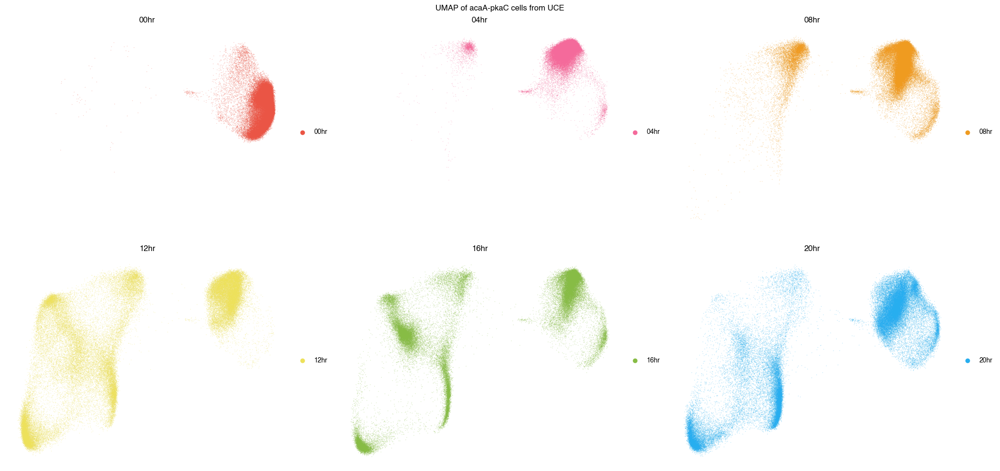

In [128]:
rows, cols = 2, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 10))

# Plot each embedding
sc.pl.embedding(
    adata_acaA_pkaC_new_00hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0][0],
    show=False,
    title="00hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_04hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0][1],
    show=False,
    title="04hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_08hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0][2],
    show=False,
    title="08hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_12hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1][0],
    show=False,
    title="12hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_16hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1][1],
    show=False,
    title="16hr",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_20hr,
    basis='X_uce_umap_AX4',
    color='time',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1][2],
    show=False,
    title="20hr",
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(2):
    for j in range(3):
        xlims.append(ax[i][j].get_xlim())
        ylims.append(ax[i][j].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(2):
    for j in range(3):
        ax[i][j].set_xlim(x_min, x_max)
        ax[i][j].set_ylim(y_min, y_max)
        
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

# Add title and adjust layout
plt.suptitle("UMAP of acaA-pkaC cells from UCE")
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC_time_ontoAX4.pdf", dpi=1200, backend="pgf")
plt.show()

Let's classify the cells as prestalk or prespore at specific time points (12 hours, 16 hours, and 20 hours).

## 12 hours

In [129]:
adata_acaA_pkaC_new_12hr_subset = adata_acaA_pkaC_new_subset[adata_acaA_pkaC_new_subset.obs["time"] == "12hr"]

In [130]:
umap_adata_acaA_pkaC_new_12hr_subset = umap.UMAP(random_state=42)
umap_adata_acaA_pkaC_new_12hr_subset.fit(adata_acaA_pkaC_new_12hr_subset.obsm["X_uce"]) 
adata_acaA_pkaC_new_12hr_subset.obsm["X_uce_umap"] = umap_adata_acaA_pkaC_new_12hr_subset.transform(adata_acaA_pkaC_new_12hr_subset.obsm["X_uce"])


In [131]:
sc.pp.neighbors(adata_acaA_pkaC_new_12hr_subset, use_rep='X_uce')
sc.tl.leiden(adata_acaA_pkaC_new_12hr_subset, resolution=0.7)

In [132]:
adata_acaA_pkaC_new_12hr_norm = adata_acaA_pkaC_new_12hr_subset.copy()
adata_acaA_pkaC_new_12hr_norm.X = np.log1p(adata_acaA_pkaC_new_12hr_norm.X)

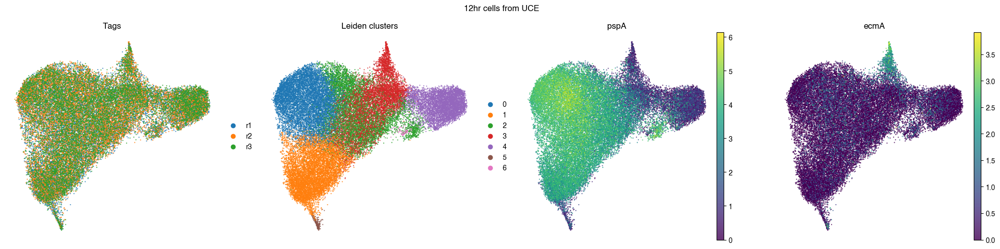

In [133]:
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
sc.pl.embedding(
    adata_acaA_pkaC_new_12hr_subset,
    basis='X_uce_umap',
    color='marker',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Tags",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_12hr_subset,
    basis='X_uce_umap',
    color='leiden',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters", 
)
sc.pl.embedding(
    adata_acaA_pkaC_new_12hr_norm,
    basis='X_uce_umap',
    color='pspA',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[2],
    show=False,
    title="pspA", 
)
sc.pl.embedding(
    adata_acaA_pkaC_new_12hr_norm,
    basis='X_uce_umap',
    color='ecmA',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[3],
    show=False,
    title="ecmA", 
)
plt.suptitle("12hr cells from UCE")
plt.tight_layout()
plt.show()

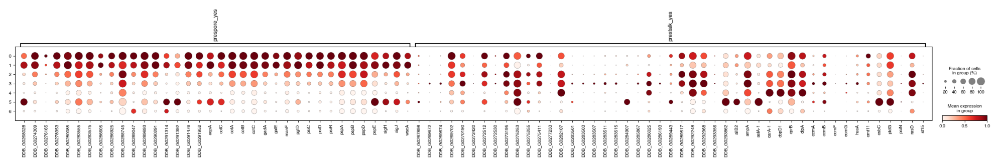

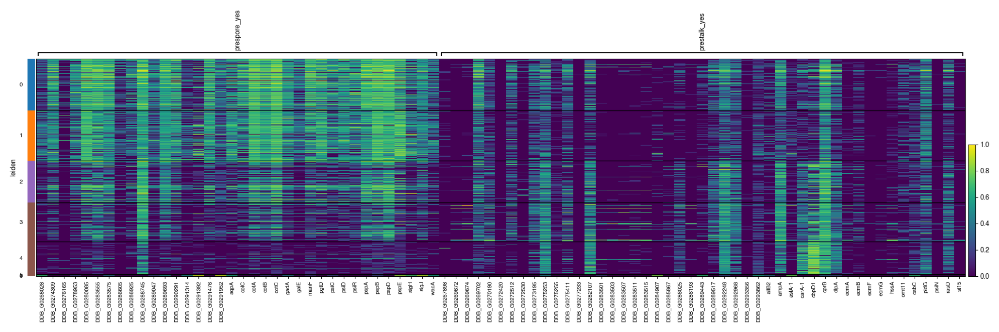

In [134]:
sc.pl.dotplot(
    adata_acaA_pkaC_new_12hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    standard_scale="var",
    show=False,
    save="dotplot_acaA_pkaC_12hr_yes.png",
)
sc.pl.heatmap(
    adata_acaA_pkaC_new_12hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    use_raw=False,
    standard_scale="var",
    show=False,
    show_gene_labels=True,
    save="_heatmap_acaA_pkaC_12hr_yes.png",
)
plt.close("all")

dotplot_img = mpimg.imread('figures/dotplot_dotplot_acaA_pkaC_12hr_yes.png')
heatmap_img = mpimg.imread('figures/heatmap_heatmap_acaA_pkaC_12hr_yes.png')
fig, axes = plt.subplots(1, 1, figsize=(20, 5))
axes.imshow(dotplot_img)
axes.axis('off')
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 1, figsize=(20, 10))
axes.imshow(heatmap_img)
axes.axis('off')
plt.tight_layout()
plt.show()

In [135]:
sc.tl.rank_genes_groups(
    adata_acaA_pkaC_new_12hr_norm, groupby="leiden", method="wilcoxon", key_added="dea_leiden_2"
)
sc.pl.rank_genes_groups_dotplot(
    adata_acaA_pkaC_new_12hr_norm,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_2",
    show=False,
    save="geneplot_acaA_pkaC_12hr.png",
)
plt.close("all")

In [136]:
annotation = {
    "0": "psp",
    "1": "psp",
    "3": "pst",
}
adata_acaA_pkaC_new_12hr_subset.obs["12hr_annot"] = adata_acaA_pkaC_new_12hr_subset.obs.leiden.map(annotation)
adata_acaA_pkaC_new_12hr_subset.obs["12hr_annot"] = adata_acaA_pkaC_new_12hr_subset.obs["12hr_annot"].astype('category')

In [137]:
adata_acaA_pkaC_new.obs["12hr_annot"] = adata_acaA_pkaC_new_12hr_subset.obs["12hr_annot"]
adata_acaA_pkaC_new_12hr.obs["12hr_annot"] = adata_acaA_pkaC_new_12hr_subset.obs["12hr_annot"]

In [138]:
sc.pl.embedding(
    adata_acaA_pkaC_new_12hr_subset,
    basis='X_uce_umap',
    color='12hr_annot',
    size=10,
    alpha=0.8,
    frameon=False,
    show=False,
    title="Cell Type",
    save="celltype_acaA_pkaC_12hr.png",
)
plt.close("all")

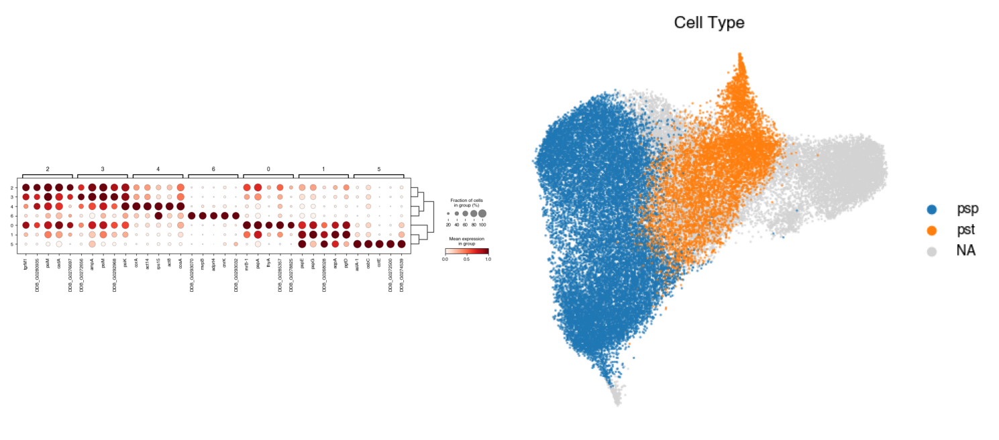

In [139]:
dotplot_img = mpimg.imread('figures/dotplot_geneplot_acaA_pkaC_12hr.png')
heatmap_img = mpimg.imread('figures/X_uce_umapcelltype_acaA_pkaC_12hr.png')
fig, axes = plt.subplots(1, 2, figsize=(15, 7))
axes[0].imshow(dotplot_img)
axes[0].axis('off')
axes[1].imshow(heatmap_img)
axes[1].axis('off')
plt.tight_layout()
plt.show()

In [140]:
annotation

{'0': 'psp', '1': 'psp', '3': 'pst'}

## 16 hours

In [141]:
adata_acaA_pkaC_new_16hr_subset = adata_acaA_pkaC_new_subset[adata_acaA_pkaC_new_subset.obs["time"] == "16hr"]

In [142]:
umap_adata_acaA_pkaC_new_16hr_subset = umap.UMAP(random_state=42)
umap_adata_acaA_pkaC_new_16hr_subset.fit(adata_acaA_pkaC_new_16hr_subset.obsm["X_uce"]) 
adata_acaA_pkaC_new_16hr_subset.obsm["X_uce_umap"] = umap_adata_acaA_pkaC_new_16hr_subset.transform(adata_acaA_pkaC_new_16hr_subset.obsm["X_uce"])

In [143]:
sc.pp.neighbors(adata_acaA_pkaC_new_16hr_subset, use_rep='X_uce')
sc.tl.leiden(adata_acaA_pkaC_new_16hr_subset, resolution=0.7)

In [144]:
adata_acaA_pkaC_new_16hr_norm = adata_acaA_pkaC_new_16hr_subset.copy()
adata_acaA_pkaC_new_16hr_norm.X = np.log1p(adata_acaA_pkaC_new_16hr_norm.X)

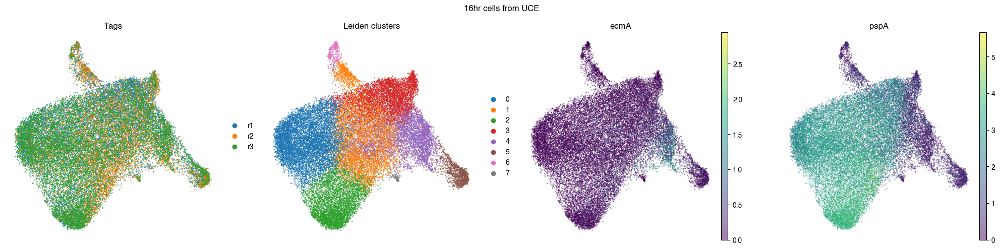

In [145]:
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
sc.pl.embedding(
    adata_acaA_pkaC_new_16hr_subset,
    basis='X_uce_umap',
    color='marker',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Tags",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_16hr_subset,
    basis='X_uce_umap',
    color='leiden',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters", 
)
sc.pl.embedding(
    adata_acaA_pkaC_new_16hr_norm,
    basis='X_uce_umap',
    color='ecmA',
    size=10,
    alpha=0.5,
    frameon=False,
    ax=ax[2],
    show=False,
    title="ecmA", 
)
sc.pl.embedding(
    adata_acaA_pkaC_new_16hr_norm,
    basis='X_uce_umap',
    color='pspA',
    size=10,
    alpha=0.5,
    frameon=False,
    ax=ax[3],
    show=False,
    title="pspA", 
)
plt.suptitle("16hr cells from UCE")
plt.tight_layout()
plt.show()

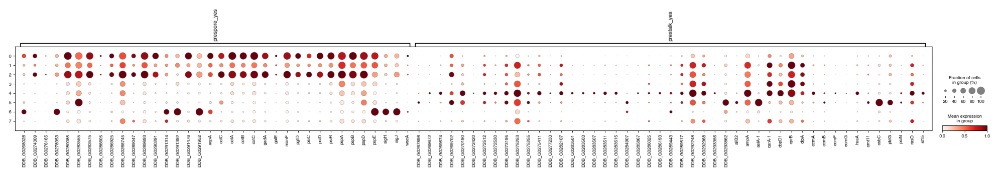

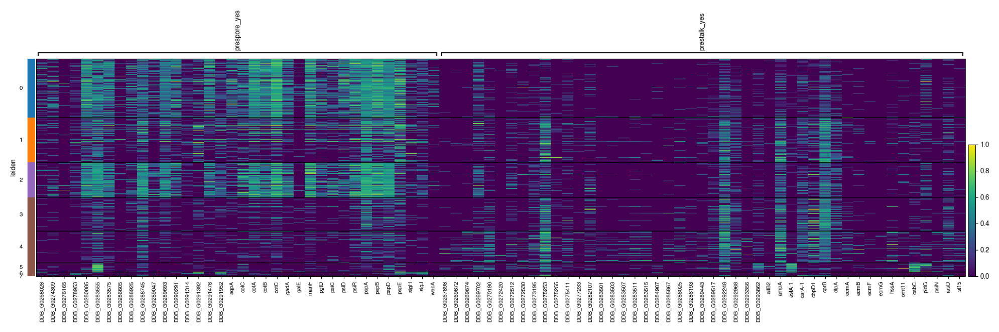

In [146]:
sc.pl.dotplot(
    adata_acaA_pkaC_new_16hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    standard_scale="var",
    show=False,
    save="dotplot_acaA_pkaC_16hr_yes.png",
)
sc.pl.heatmap(
    adata_acaA_pkaC_new_16hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    use_raw=False,
    standard_scale="var",
    show=False,
    show_gene_labels=True,
    save="_heatmap_acaA_pkaC_16hr_yes.png",
)
plt.close("all")

dotplot_img = mpimg.imread('figures/dotplot_dotplot_acaA_pkaC_16hr_yes.png')
heatmap_img = mpimg.imread('figures/heatmap_heatmap_acaA_pkaC_16hr_yes.png')
fig, axes = plt.subplots(1, 1, figsize=(20, 5))
axes.imshow(dotplot_img)
axes.axis('off')
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 1, figsize=(20, 10))
axes.imshow(heatmap_img)
axes.axis('off')
plt.tight_layout()
plt.show()

In [147]:
sc.tl.rank_genes_groups(
    adata_acaA_pkaC_new_16hr_norm, groupby="leiden", method="wilcoxon", key_added="dea_leiden_2"
)
sc.pl.rank_genes_groups_dotplot(
    adata_acaA_pkaC_new_16hr_norm,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_2",
    show=False,
    save="geneplot_acaA_pkaC_16hr.png",
)
plt.close("all")

In [148]:
annotation = {
    "4": "pst",
    "0": "psp",
    "2": "psp",
}
adata_acaA_pkaC_new_16hr_subset.obs["16hr_annot"] = adata_acaA_pkaC_new_16hr_subset.obs.leiden.map(annotation)
adata_acaA_pkaC_new_16hr_subset.obs["16hr_annot"] = adata_acaA_pkaC_new_16hr_subset.obs["16hr_annot"].astype('category')

In [149]:
adata_acaA_pkaC_new.obs["16hr_annot"] = adata_acaA_pkaC_new_16hr_subset.obs["16hr_annot"]
adata_acaA_pkaC_new_16hr.obs["16hr_annot"] = adata_acaA_pkaC_new_16hr_subset.obs["16hr_annot"]

In [150]:
sc.pl.embedding(
    adata_acaA_pkaC_new_16hr_subset,
    basis='X_uce_umap',
    color='16hr_annot',
    size=10,
    alpha=0.8,
    frameon=False,
    show=False,
    title="Cell Type",
    save="celltype_acaA_pkaC_16hr.png",
)
plt.close("all")

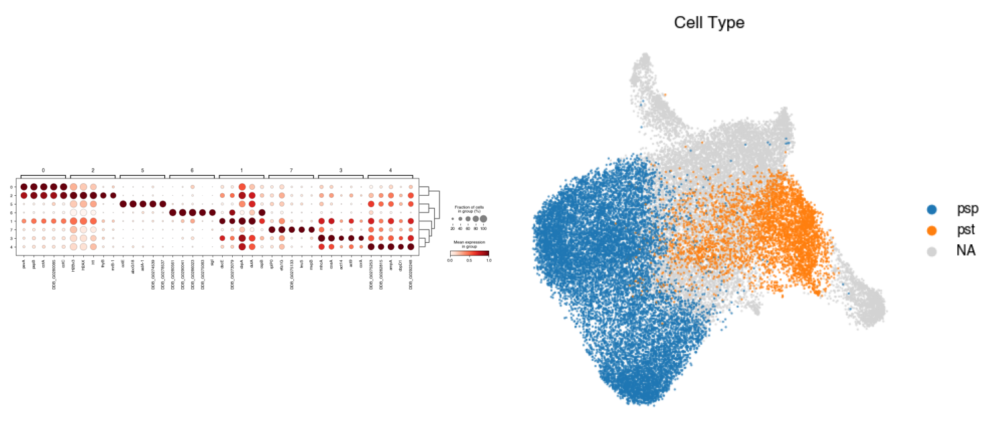

In [151]:
dotplot_img = mpimg.imread('figures/dotplot_geneplot_acaA_pkaC_16hr.png')
heatmap_img = mpimg.imread('figures/X_uce_umapcelltype_acaA_pkaC_16hr.png')
fig, axes = plt.subplots(1, 2, figsize=(15, 7))
axes[0].imshow(dotplot_img)
axes[0].axis('off')
axes[1].imshow(heatmap_img)
axes[1].axis('off')
plt.tight_layout()
plt.show()

In [152]:
annotation

{'4': 'pst', '0': 'psp', '2': 'psp'}

## 20 hours

In [153]:
adata_acaA_pkaC_new_20hr_subset = adata_acaA_pkaC_new_subset[adata_acaA_pkaC_new_subset.obs["time"] == "20hr"]

In [154]:
umap_adata_acaA_pkaC_new_20hr_subset = umap.UMAP(random_state=42)
umap_adata_acaA_pkaC_new_20hr_subset.fit(adata_acaA_pkaC_new_20hr_subset.obsm["X_uce"]) 
adata_acaA_pkaC_new_20hr_subset.obsm["X_uce_umap"] = umap_adata_acaA_pkaC_new_20hr_subset.transform(adata_acaA_pkaC_new_20hr_subset.obsm["X_uce"])

In [155]:
sc.pp.neighbors(adata_acaA_pkaC_new_20hr_subset, use_rep='X_uce')
sc.tl.leiden(adata_acaA_pkaC_new_20hr_subset, resolution=0.7)

In [156]:
adata_acaA_pkaC_new_20hr_norm = adata_acaA_pkaC_new_20hr_subset.copy()
adata_acaA_pkaC_new_20hr_norm.X = np.log1p(adata_acaA_pkaC_new_20hr_norm.X)

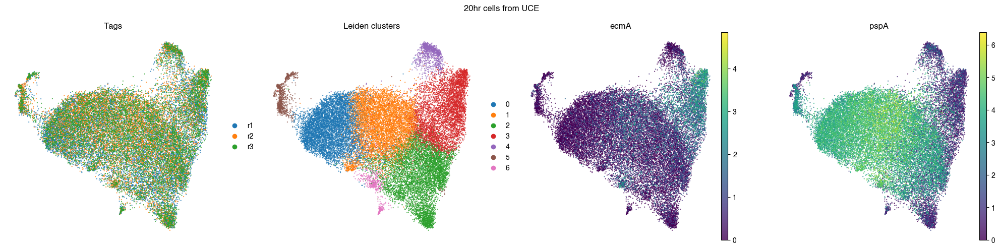

In [157]:
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
sc.pl.embedding(
    adata_acaA_pkaC_new_20hr_subset,
    basis='X_uce_umap',
    color='marker',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Tags",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_20hr_subset,
    basis='X_uce_umap',
    color='leiden',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Leiden clusters", 
)
sc.pl.embedding(
    adata_acaA_pkaC_new_20hr_norm,
    basis='X_uce_umap',
    color='ecmA',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[2],
    show=False,
    title="ecmA", 
)
sc.pl.embedding(
    adata_acaA_pkaC_new_20hr_norm,
    basis='X_uce_umap',
    color='pspA',
    size=10,
    alpha=0.8,
    frameon=False,
    ax=ax[3],
    show=False,
    title="pspA", 
)
ax[2].axis('off')  # Turn off the axes
plt.suptitle("20hr cells from UCE")
plt.tight_layout()
plt.show()

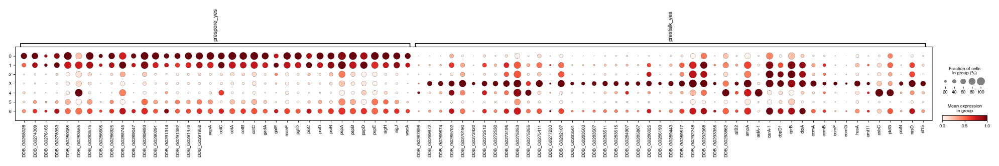

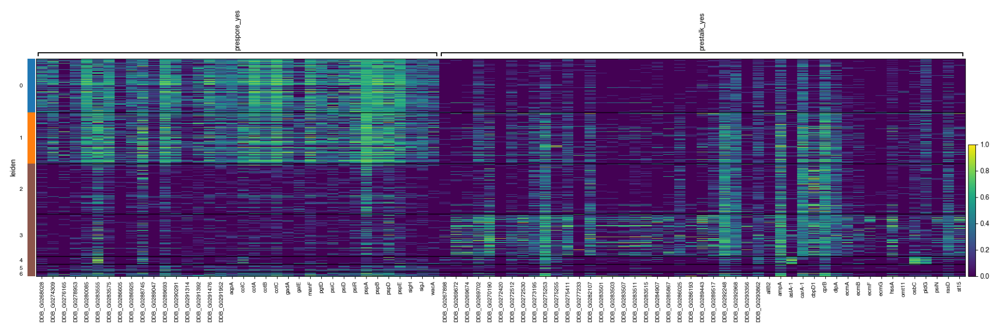

In [158]:
sc.pl.dotplot(
    adata_acaA_pkaC_new_20hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    standard_scale="var",
    show=False,
    save="dotplot_acaA_pkaC_20hr_yes.png",
)
sc.pl.heatmap(
    adata_acaA_pkaC_new_20hr_norm,
    groupby="leiden",
    var_names=yes_markers,
    use_raw=False,
    standard_scale="var",
    show=False,
    show_gene_labels=True,
    save="_heatmap_acaA_pkaC_20hr_yes.png",
)
plt.close("all")

dotplot_img = mpimg.imread('figures/dotplot_dotplot_acaA_pkaC_20hr_yes.png')
heatmap_img = mpimg.imread('figures/heatmap_heatmap_acaA_pkaC_20hr_yes.png')
fig, axes = plt.subplots(1, 1, figsize=(20, 5))
axes.imshow(dotplot_img)
axes.axis('off')
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 1, figsize=(20, 10))
axes.imshow(heatmap_img)
axes.axis('off')
plt.tight_layout()
plt.show()

In [159]:
sc.tl.rank_genes_groups(
    adata_acaA_pkaC_new_20hr_norm, groupby="leiden", method="wilcoxon", key_added="dea_leiden_2"
)
sc.pl.rank_genes_groups_dotplot(
    adata_acaA_pkaC_new_20hr_norm,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_2",
    show=False,
    save="geneplot_acaA_pkaC_20hr.png",
)
plt.close("all")

In [160]:
annotation = {
    "0": "psp",
    "1": "psp",
    "3": "pst",
}
adata_acaA_pkaC_new_20hr_subset.obs["20hr_annot"] = adata_acaA_pkaC_new_20hr_subset.obs.leiden.map(annotation)
adata_acaA_pkaC_new_20hr_subset.obs["20hr_annot"] = adata_acaA_pkaC_new_20hr_subset.obs["20hr_annot"].astype('category')

In [161]:
adata_acaA_pkaC_new.obs["20hr_annot"] = adata_acaA_pkaC_new_20hr_subset.obs["20hr_annot"]
adata_acaA_pkaC_new_20hr.obs["20hr_annot"] = adata_acaA_pkaC_new_20hr_subset.obs["20hr_annot"]

In [162]:
sc.pl.embedding(
    adata_acaA_pkaC_new_20hr_subset,
    basis='X_uce_umap',
    color='20hr_annot',
    size=10,
    alpha=0.8,
    frameon=False,
    show=False,
    title="Cell Type",
    save="celltype_acaA_pkaC_20hr.png",
)
plt.close("all")

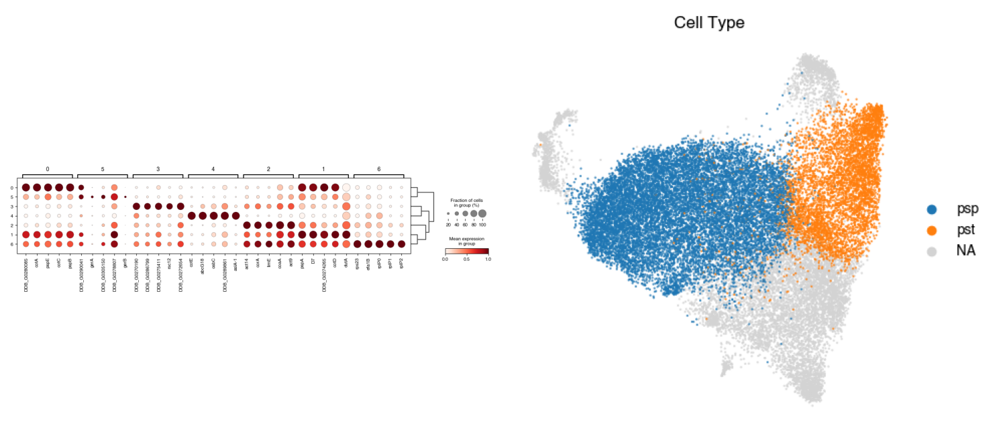

In [163]:
dotplot_img = mpimg.imread('figures/dotplot_geneplot_acaA_pkaC_20hr.png')
heatmap_img = mpimg.imread('figures/X_uce_umapcelltype_acaA_pkaC_20hr.png')
fig, axes = plt.subplots(1, 2, figsize=(15, 7))
axes[0].imshow(dotplot_img)
axes[0].axis('off')
axes[1].imshow(heatmap_img)
axes[1].axis('off')
plt.tight_layout()
plt.show()

In [164]:
annotation

{'0': 'psp', '1': 'psp', '3': 'pst'}

## Combine the annotations

In [165]:
# Combine all unique categories from the annotation columns
all_categories = (
    adata_acaA_pkaC_new.obs['12hr_annot'].cat.categories
    .union(adata_acaA_pkaC_new.obs['16hr_annot'].cat.categories)
    .union(adata_acaA_pkaC_new.obs['20hr_annot'].cat.categories)
)

# Ensure all annotation columns have the same categories
for col in ['12hr_annot', '16hr_annot', '20hr_annot']:
    adata_acaA_pkaC_new.obs[col] = adata_acaA_pkaC_new.obs[col].cat.set_categories(all_categories)

# Fill missing values in a cascading manner
adata_acaA_pkaC_new.obs['cell_type'] = (
    adata_acaA_pkaC_new.obs['12hr_annot']
    .fillna(adata_acaA_pkaC_new.obs['16hr_annot'])
    .fillna(adata_acaA_pkaC_new.obs['20hr_annot'])
).astype('category')

print(adata_acaA_pkaC_new.obs['cell_type'].value_counts())


cell_type
psp    45003
pst    16847
Name: count, dtype: int64


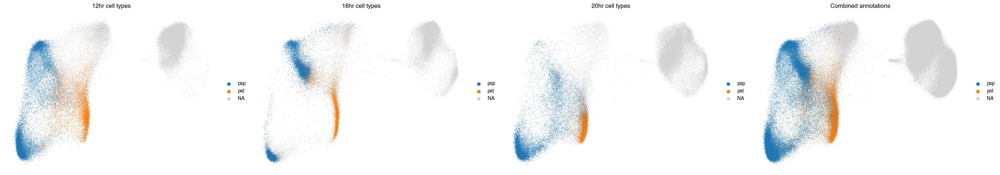

In [166]:
fig, ax = plt.subplots(1, 4, figsize=(28, 5))
sc.pl.embedding(
    adata_acaA_pkaC_new_12hr,
    basis='X_uce_umap_AX4',
    color='12hr_annot',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0],
    show=False,
    title="12hr cell types",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_16hr,
    basis='X_uce_umap_AX4',
    color='16hr_annot',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1],
    show=False,
    title="16hr cell types",
)
sc.pl.embedding(
    adata_acaA_pkaC_new_20hr,
    basis='X_uce_umap_AX4',
    color='20hr_annot',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[2],
    show=False,
    title="20hr cell types",
)
sc.pl.embedding(
    adata_acaA_pkaC_new,
    basis='X_uce_umap_AX4',
    color='cell_type',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[3],
    show=False,
    title="Combined annotations",
)
plt.tight_layout()
plt.show()

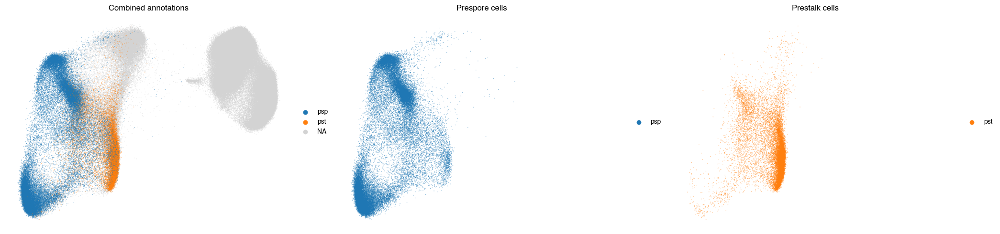

In [167]:
rows, cols = 1, 3

fig, ax = plt.subplots(rows, cols, figsize=(21, 5))
sc.pl.embedding(
    adata_acaA_pkaC_new,
    basis='X_uce_umap_AX4',
    color='cell_type',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[0],
    show=False,
    title="Combined annotations",
)
adata_acaA_pkaC_new_psp = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["cell_type"] == "psp"].copy()
sc.pl.embedding(
    adata_acaA_pkaC_new_psp,
    basis='X_uce_umap_AX4',
    color='cell_type',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[1],
    show=False,
    title="Prespore cells",
)
adata_acaA_pkaC_new_pst = adata_acaA_pkaC_new[adata_acaA_pkaC_new.obs["cell_type"] == "pst"].copy()
sc.pl.embedding(
    adata_acaA_pkaC_new_pst,
    basis='X_uce_umap_AX4',
    color='cell_type',
    size=5,
    alpha=0.5,
    frameon=False,
    ax=ax[2],
    show=False,
    title="Prestalk cells",
)

# Get the x and y limits from all subplots
xlims = []
ylims = []
for i in range(3):
    xlims.append(ax[i].get_xlim())
    ylims.append(ax[i].get_ylim())

# Find the common limits
x_min, x_max = min([x[0] for x in xlims]), max([x[1] for x in xlims])
y_min, y_max = min([y[0] for y in ylims]), max([y[1] for y in ylims])

# Set the common limits for all subplots
for i in range(3):
    ax[i].set_xlim(x_min, x_max)
    ax[i].set_ylim(y_min, y_max)
    
for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)
    
    
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC_cell_types.pdf", dpi=1200, backend="pgf")
plt.show()

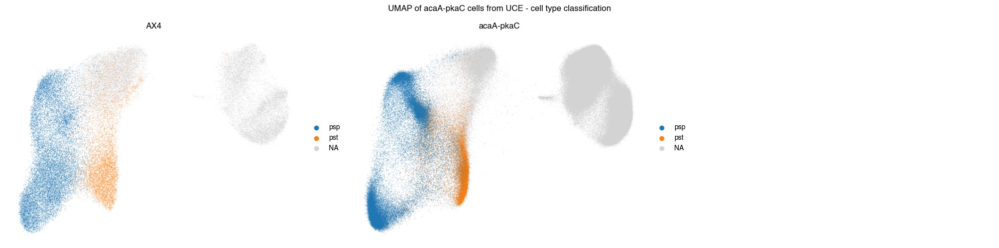

In [168]:

# Ensure categorical format for cell_type
adata_new.obs['cell_type'] = adata_new.obs['cell_type'].astype('category')
adata_acaA_pkaC_new.obs['cell_type'] = adata_acaA_pkaC_new.obs['cell_type'].astype('category')

rows, cols = 1, 3
# Create subplots
fig, ax = plt.subplots(rows, cols, figsize=(20, 5))

# Plot each embedding with the updated color scheme
sc.pl.embedding(
    adata_new,
    basis='X_uce_umap',
    color='cell_type',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[0],
    show=False,
    title="AX4",
)
sc.pl.embedding(
    adata_acaA_pkaC_new,
    basis='X_uce_umap_AX4',
    color='cell_type',
    size=5,
    alpha=0.3,
    frameon=False,
    ax=ax[1],
    show=False,
    title="acaA-pkaC",
)

# Hide third subplot
ax[2].axis('off')

for i in range(rows):
    for j in range(cols):
        if rows > 1:
            subplot = ax[i][j]
        else:
            subplot = ax[j]
        for coll in subplot.collections:
            coll.set_rasterized(True)

# Add title and adjust layout
plt.suptitle("UMAP of acaA-pkaC cells from UCE - cell type classification")
plt.tight_layout()
plt.savefig("../results/figures/acaA_pkaC/acaA_pkaC_AX4_cell_types.pdf", dpi=1200, backend="pgf")
plt.show()

In [169]:
adata_acaA_pkaC_new.write(f"../data/processed/acaA_pkaC.h5ad")

In [170]:
del adata_acaA_pkaC_new
del adata_acaA_pkaC_new_norm
gc.collect()

125793

# Synchronicity profiling

To visualize the synchronicity of cells at each time point, we will calculate the mean Euclidean distance between the embeddings of individual cells and the average embedding for their respective time point. By comparing these mean distances across all time points, we can observe how cell synchronicity changes over time. The code for this analysis is in the `03_synchronicity.ipynb` notebook.

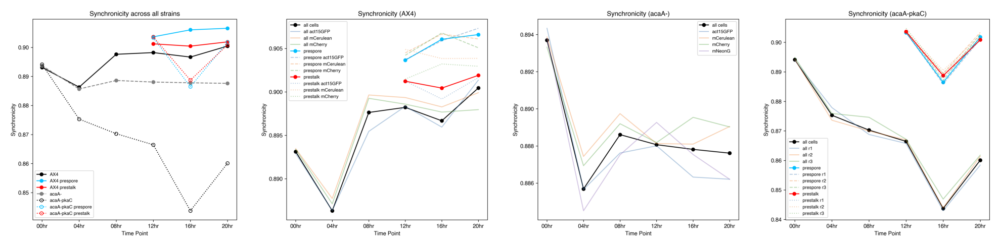

AX4:
Number of prespore cells at 12hr, 16hr, 20hr:  {'12hr': 5875, '16hr': 7729, '20hr': 6594}
Number of prestalk cells at 12hr, 16hr, 20hr:  {'12hr': 1750, '16hr': 3584, '20hr': 1999}
Percentages from prespore and prestalk: 77.05%, 68.32%, 76.74%

acaA-pkaC:
Number of prespore cells at 12hr, 16hr, 20hr:  {'12hr': 18531, '16hr': 13225, '20hr': 13247}
Number of prestalk cells at 12hr, 16hr, 20hr:  {'12hr': 7077, '16hr': 4443, '20hr': 5327}
Percentages from prespore and prestalk: 72.36%, 74.85%, 71.32%



In [ ]:
fig, axes = plt.subplots(1, 4, figsize=(20, 5))
axes[0].imshow(mpimg.imread('../results/figures/synchronicity/all.png'))
axes[0].axis('off')
axes[1].imshow(mpimg.imread('../results/figures/synchronicity/AX4.png'))
axes[1].axis('off')
axes[2].imshow(mpimg.imread('../results/figures/synchronicity/acaA.png'))
axes[2].axis('off')
axes[3].imshow(mpimg.imread('../results/figures/synchronicity/acaA_pkaC.png'))
axes[3].axis('off')
plt.tight_layout()
plt.show()

with open('../results/other/prespore_prestalk_numbers.txt', 'r') as file:
    loaded_text = file.read()
print(loaded_text)
with open('../results/other/prespore_prestalk_numbers_acaA_pkaC.txt', 'r') as file:
    loaded_text = file.read()
print(loaded_text)

Let's use bootstrapping to estimate confidence intervals for the mean cosine distances for time point. We bootstrapped the mean cosine distance from the mean embedding from different replicates.

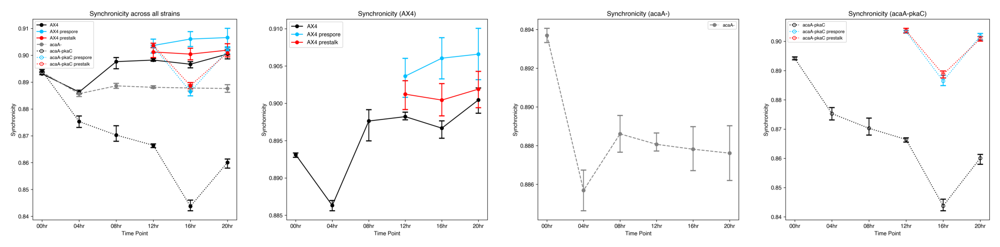

In [9]:
fig, axes = plt.subplots(1, 4, figsize=(20, 5))
axes[0].imshow(mpimg.imread('../results/figures/synchronicity/all_error.png'))
axes[0].axis('off')
axes[1].imshow(mpimg.imread('../results/figures/synchronicity/AX4_error.png'))
axes[1].axis('off')
axes[2].imshow(mpimg.imread('../results/figures/synchronicity/acaA_error.png'))
axes[2].axis('off')
axes[3].imshow(mpimg.imread('../results/figures/synchronicity/acaA_pkaC_error.png'))
axes[3].axis('off')
plt.tight_layout()
plt.show()

UCE embeddings give us the expected trend, the same analysis using the Euclidean distance from the first 50 components of PCA embeddings gives us the following trend.

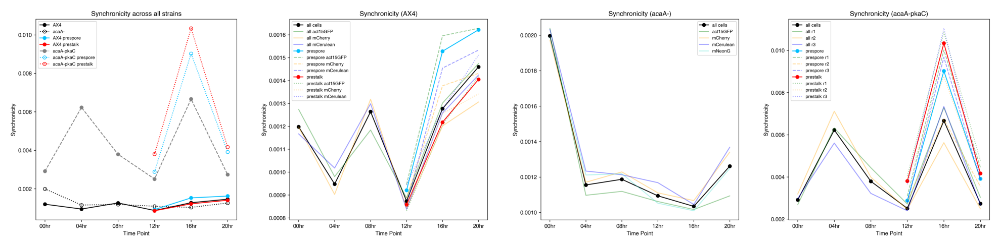

In [10]:
fig, axes = plt.subplots(1, 4, figsize=(20, 5))
axes[0].imshow(mpimg.imread('figures/diversity_uce_pca.png'))
axes[0].axis('off')
axes[1].imshow(mpimg.imread('figures/diversity_uce_ax4_pca.png'))
axes[1].axis('off')
axes[2].imshow(mpimg.imread('figures/diversity_uce_acaA_pca.png'))
axes[2].axis('off')
axes[3].imshow(mpimg.imread('figures/diversity_uce_acaA_pkaC_pca.png'))
axes[3].axis('off')
plt.tight_layout()
plt.show()

In [11]:
!jupyter nbconvert --to html --TemplateExporter.exclude_input=True UCE.ipynb --output-dir=../../../lenatr99.github.io --output=index.html > /dev/null 2>&1